# Building a Conditional GAN

### Goals
In this notebook, we're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learning the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

We will be using the MNIST dataset again.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [10]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [11]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [12]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes.



In [13]:


import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    return F.one_hot(labels,n_classes)

Next, we need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.


In [15]:
# combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    combined = torch.cat([x.float(),y.float()],dim=1)
    return combined

## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [17]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [18]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [19]:
# get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''

    generator_input_dim = z_dim+n_classes
    discriminator_im_chan = mnist_shape[0]+n_classes

    return generator_input_dim, discriminator_im_chan

In [22]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Epoch 1, step 500: Generator loss: 2.2769802430868147, discriminator loss: 0.25531649217754604


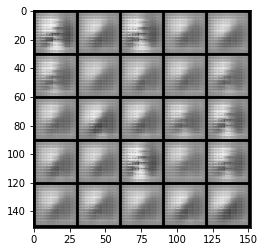

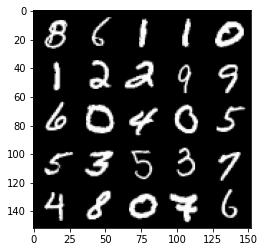

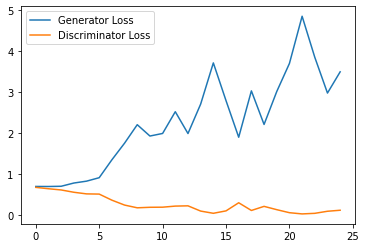

Epoch 2, step 1000: Generator loss: 4.625429337024689, discriminator loss: 0.04199629878159612


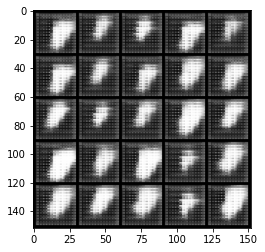

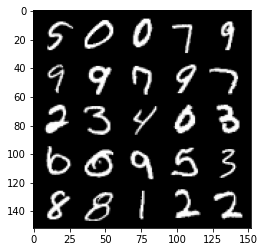

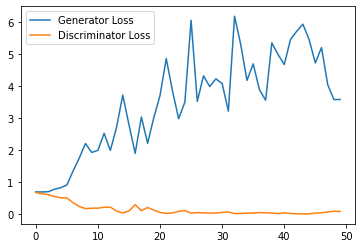

Epoch 3, step 1500: Generator loss: 4.708446284294128, discriminator loss: 0.037568922931328415


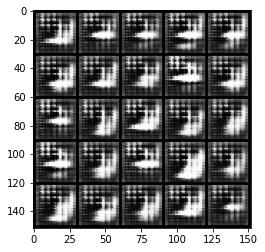

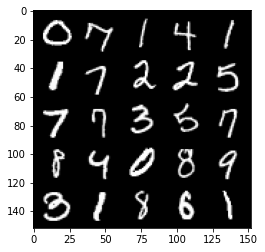

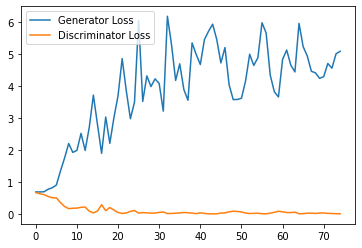

Epoch 4, step 2000: Generator loss: 4.671901123523712, discriminator loss: 0.03722720494121313


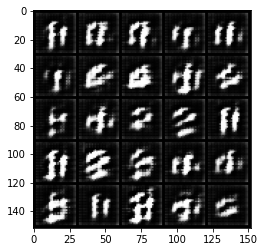

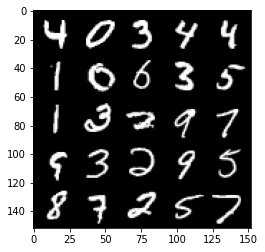

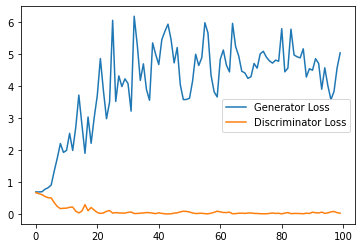

Epoch 5, step 2500: Generator loss: 3.706684633255005, discriminator loss: 0.12329263483732938


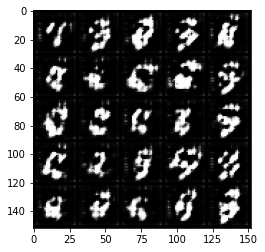

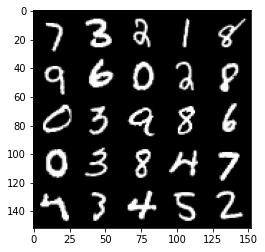

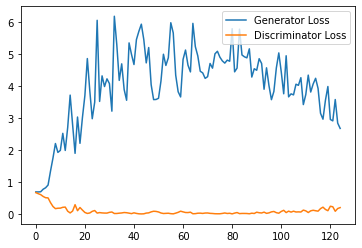

Epoch 6, step 3000: Generator loss: 2.90893878030777, discriminator loss: 0.19083516170829534


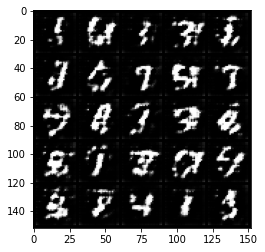

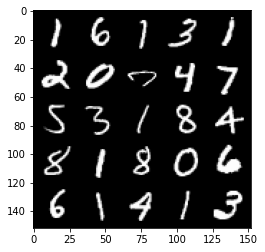

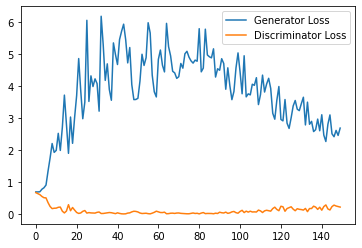

Epoch 7, step 3500: Generator loss: 2.5507053072452543, discriminator loss: 0.2743976594209671


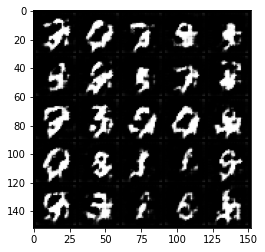

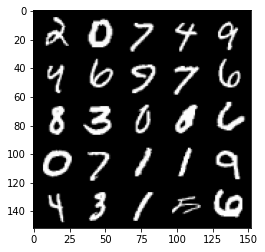

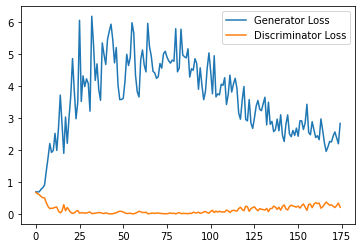

Epoch 8, step 4000: Generator loss: 2.220979143381119, discriminator loss: 0.3058440859615803


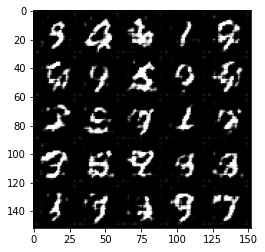

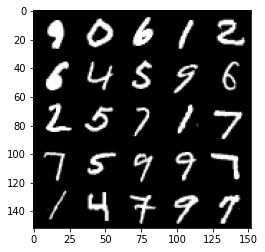

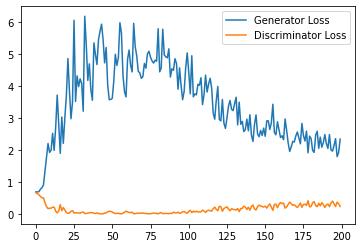

Epoch 9, step 4500: Generator loss: 2.099024257659912, discriminator loss: 0.3106178039312363


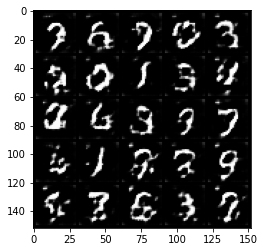

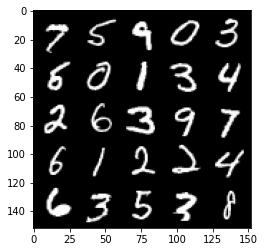

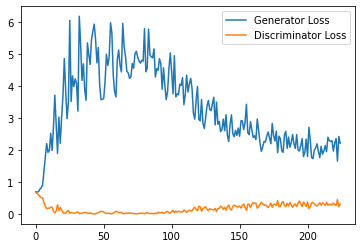

Epoch 10, step 5000: Generator loss: 2.056703119277954, discriminator loss: 0.34666598004102706


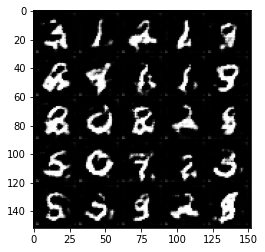

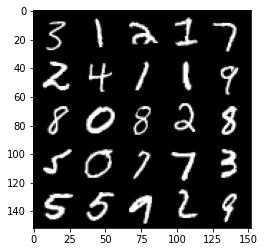

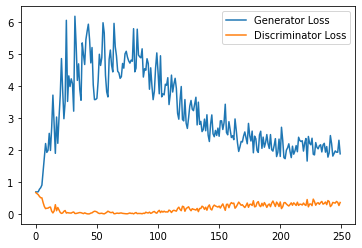

Epoch 11, step 5500: Generator loss: 1.82972966837883, discriminator loss: 0.37512403815984724


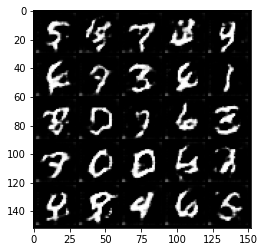

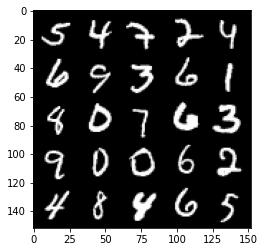

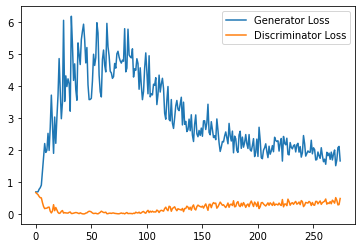

Epoch 12, step 6000: Generator loss: 1.722617704629898, discriminator loss: 0.39502473604679106


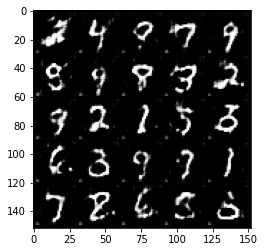

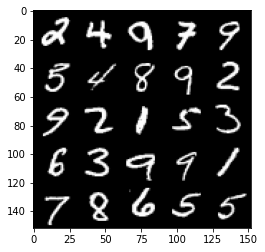

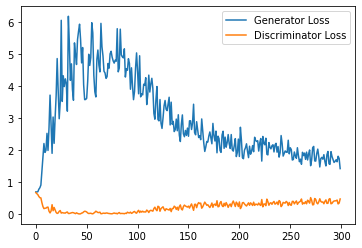

Epoch 13, step 6500: Generator loss: 1.6220294325351714, discriminator loss: 0.40585985612869263


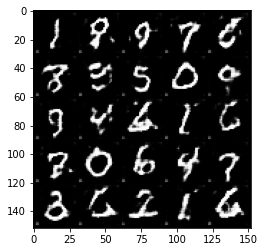

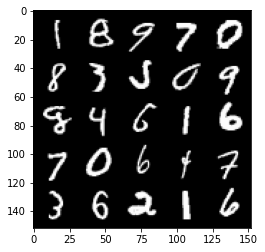

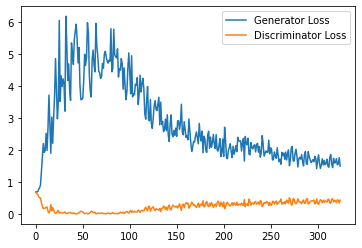

Epoch 14, step 7000: Generator loss: 1.6583865469694137, discriminator loss: 0.44725084364414214


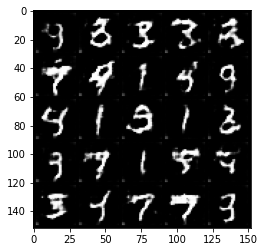

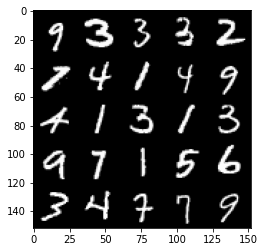

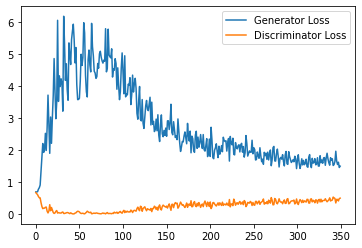

Epoch 15, step 7500: Generator loss: 1.4566808556318283, discriminator loss: 0.47514800387620926


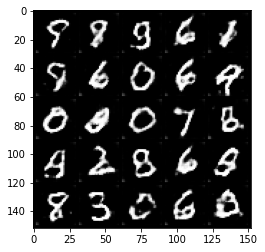

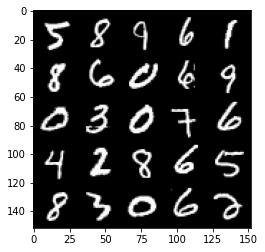

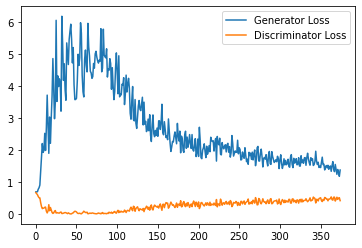

Epoch 17, step 8000: Generator loss: 1.3974536333084107, discriminator loss: 0.49703815335035323


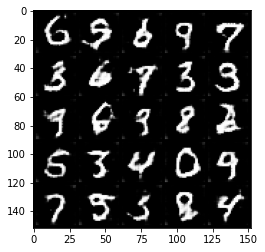

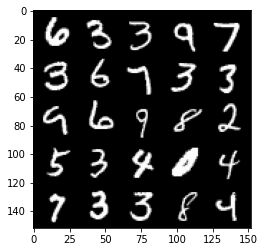

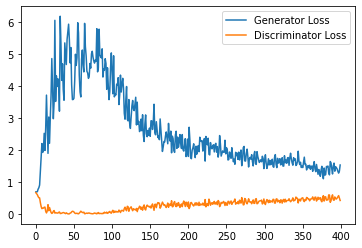

Epoch 18, step 8500: Generator loss: 1.3467352925539016, discriminator loss: 0.5180561667680741


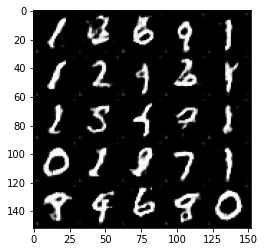

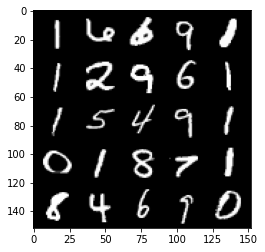

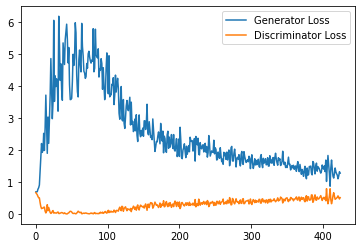

Epoch 19, step 9000: Generator loss: 1.31123741877079, discriminator loss: 0.5283947281241417


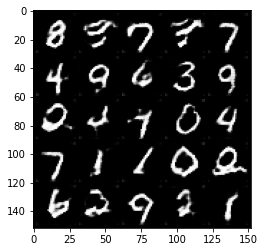

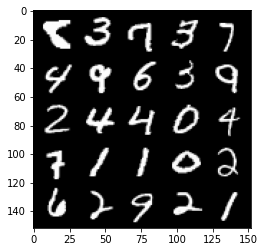

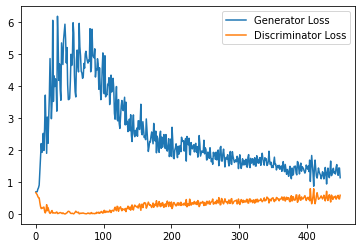

Epoch 20, step 9500: Generator loss: 1.2544307860136032, discriminator loss: 0.5401447756290436


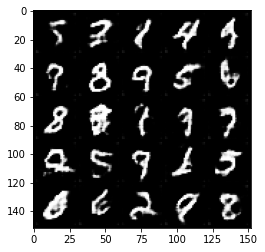

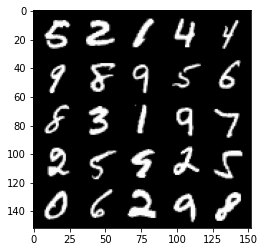

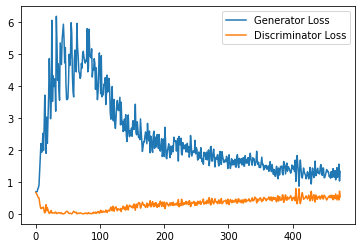

Epoch 21, step 10000: Generator loss: 1.1971914763450622, discriminator loss: 0.5555454207658768


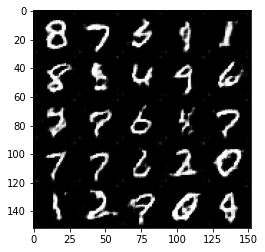

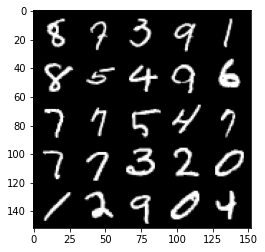

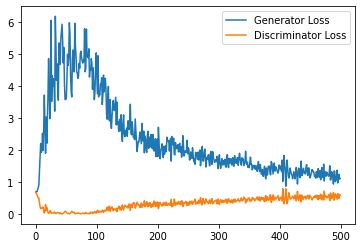

Epoch 22, step 10500: Generator loss: 1.176453164935112, discriminator loss: 0.574606029510498


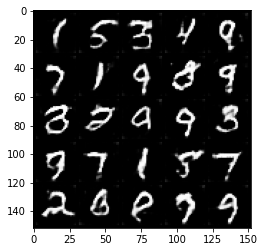

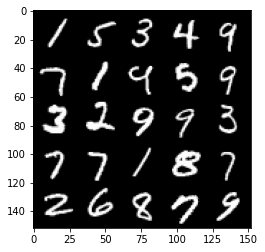

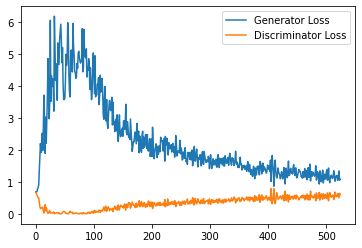

Epoch 23, step 11000: Generator loss: 1.1659707947969438, discriminator loss: 0.569627871632576


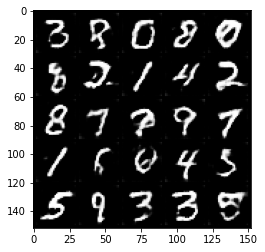

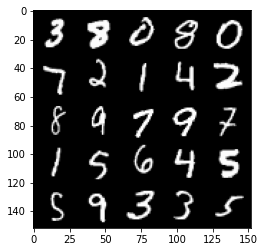

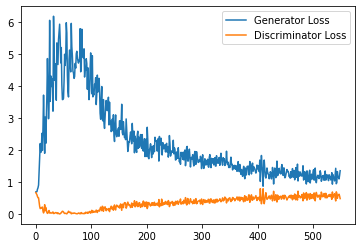

Epoch 24, step 11500: Generator loss: 1.131198365330696, discriminator loss: 0.577116728246212


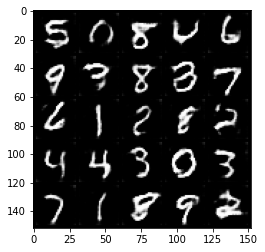

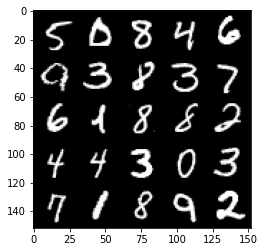

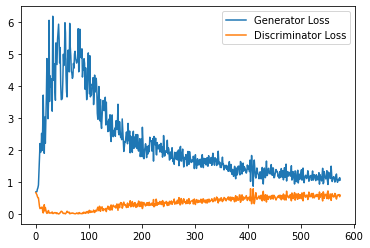

Epoch 25, step 12000: Generator loss: 1.1342489441633226, discriminator loss: 0.5749673857688904


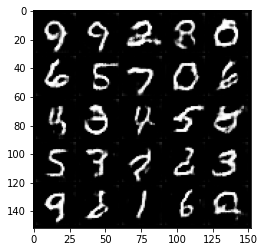

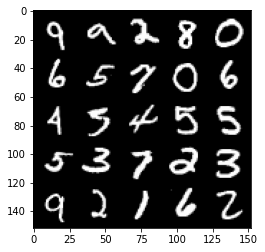

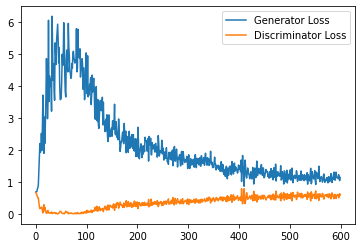

Epoch 26, step 12500: Generator loss: 1.185542199730873, discriminator loss: 0.5758412219882011


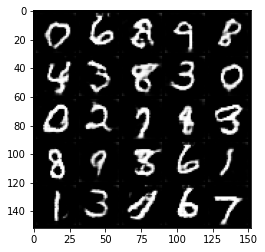

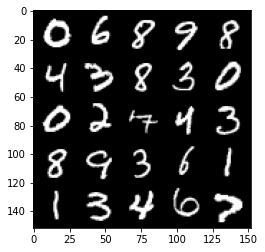

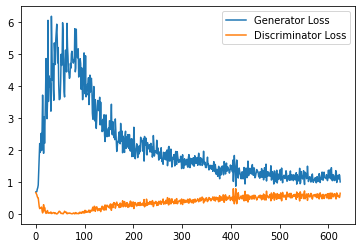

Epoch 27, step 13000: Generator loss: 1.0464717094898224, discriminator loss: 0.5766513423323631


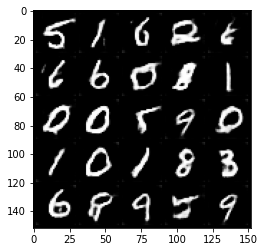

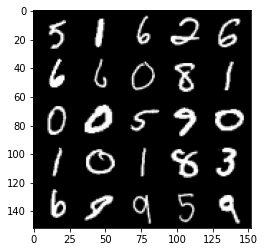

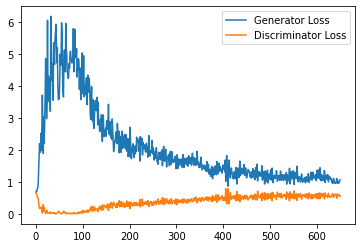

Epoch 28, step 13500: Generator loss: 1.0891462169885635, discriminator loss: 0.5854188117980957


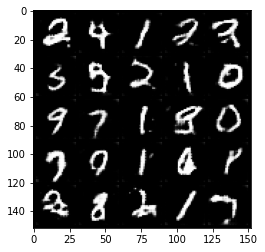

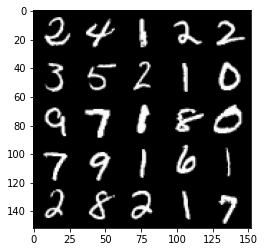

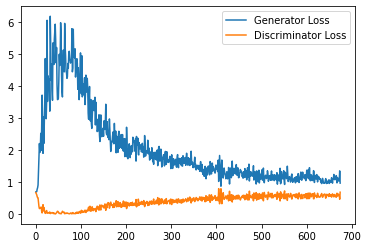

Epoch 29, step 14000: Generator loss: 1.1010907682180404, discriminator loss: 0.5813829978704452


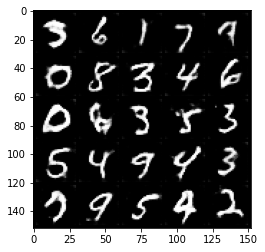

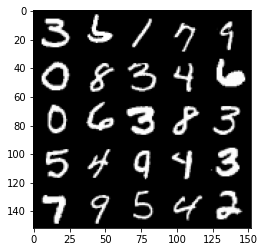

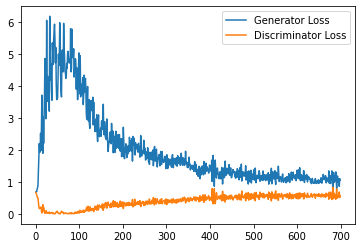

Epoch 30, step 14500: Generator loss: 1.0414296889305115, discriminator loss: 0.5865169569253922


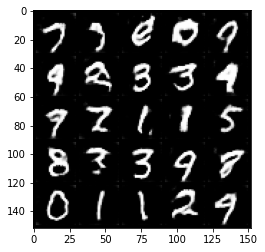

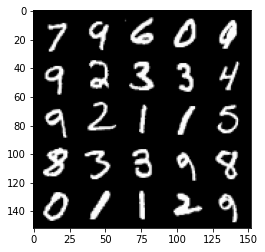

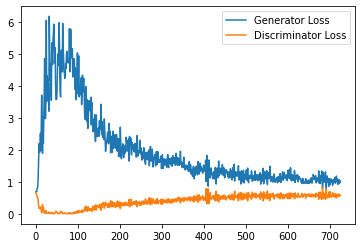

Epoch 31, step 15000: Generator loss: 1.0596511713266372, discriminator loss: 0.5805073776245118


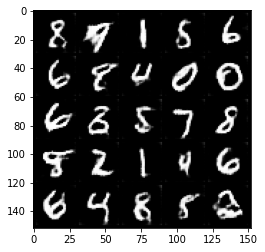

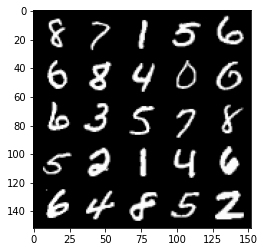

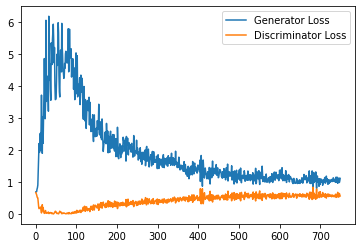

Epoch 33, step 15500: Generator loss: 1.0515729591846465, discriminator loss: 0.587439559161663


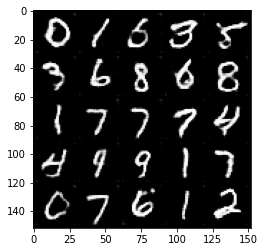

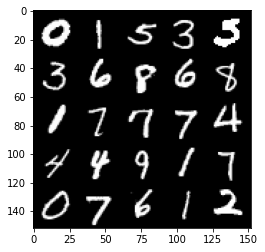

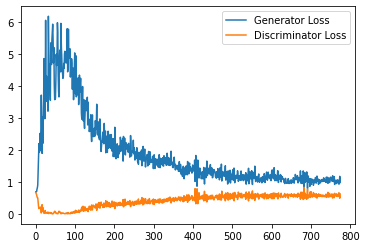

Epoch 34, step 16000: Generator loss: 1.0809024674892425, discriminator loss: 0.5973339690566063


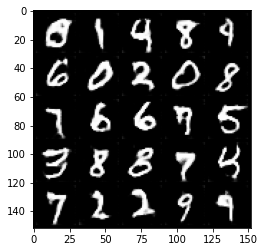

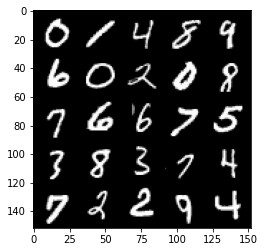

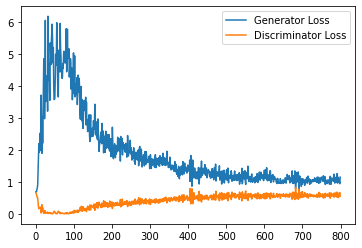

Epoch 35, step 16500: Generator loss: 1.071626568555832, discriminator loss: 0.5794489498734474


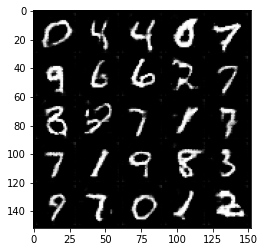

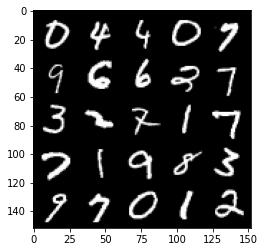

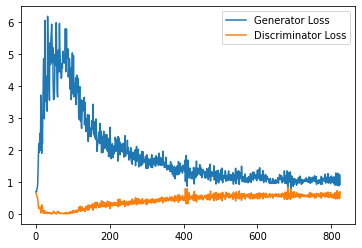

Epoch 36, step 17000: Generator loss: 1.0860150657892227, discriminator loss: 0.5883663802146911


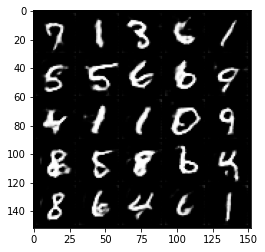

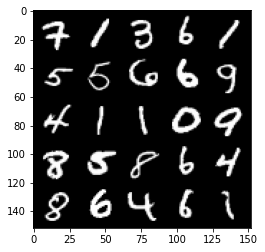

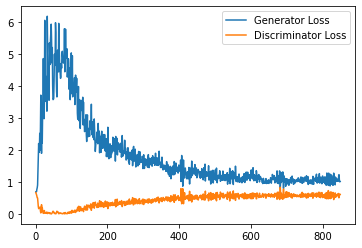

Epoch 37, step 17500: Generator loss: 1.051307036280632, discriminator loss: 0.5956689222455025


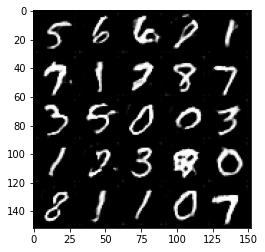

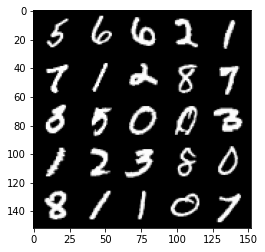

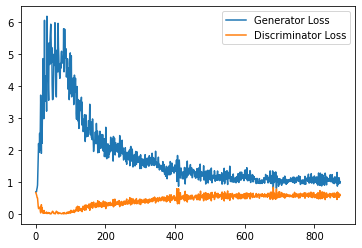

Epoch 38, step 18000: Generator loss: 1.0325022411346436, discriminator loss: 0.5958919805288315


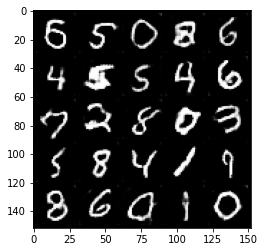

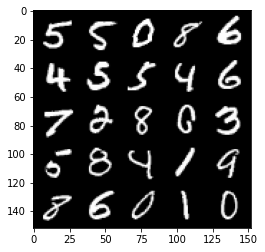

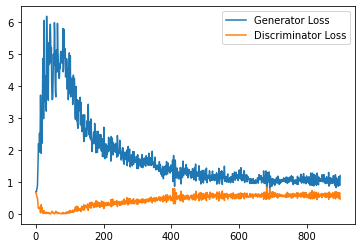

Epoch 39, step 18500: Generator loss: 1.045116626739502, discriminator loss: 0.5959002801179886


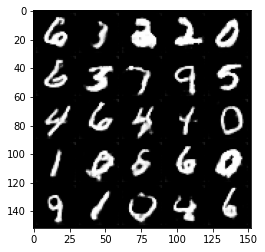

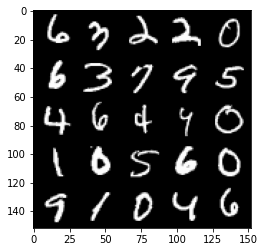

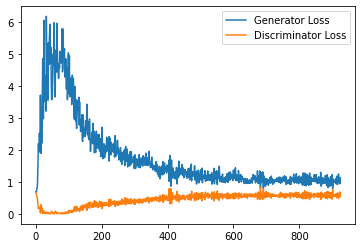

Epoch 40, step 19000: Generator loss: 1.0117307204008101, discriminator loss: 0.6071766157150269


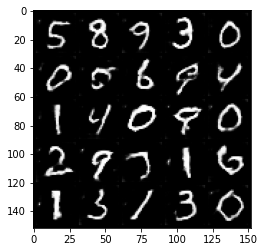

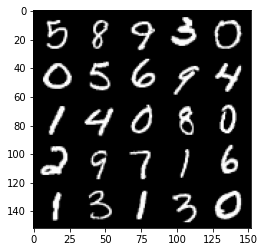

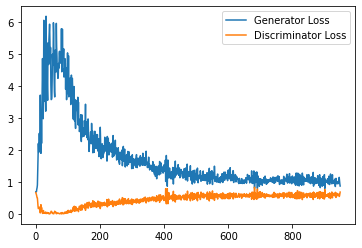

Epoch 41, step 19500: Generator loss: 1.0126362887620926, discriminator loss: 0.5988832902312279


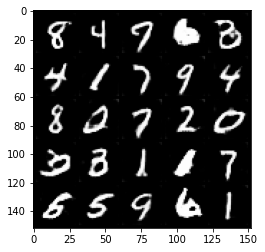

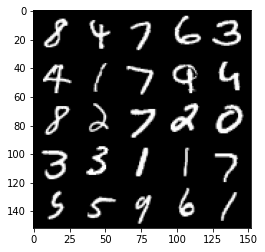

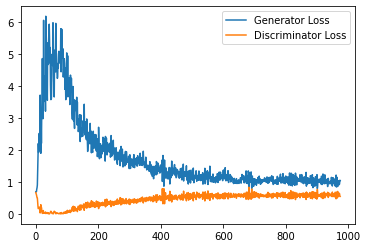

Epoch 42, step 20000: Generator loss: 1.009875762820244, discriminator loss: 0.5976728703379631


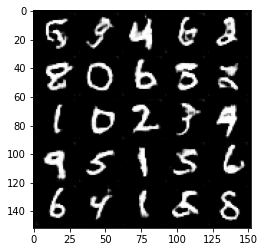

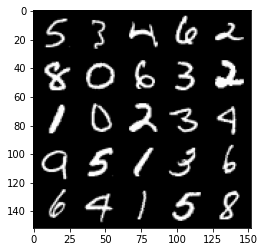

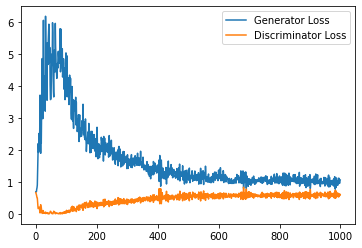

Epoch 43, step 20500: Generator loss: 0.9960566598176956, discriminator loss: 0.6024691256284713


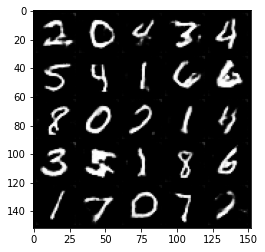

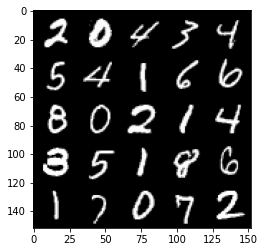

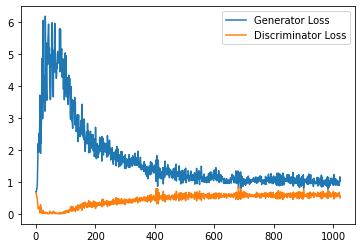

Epoch 44, step 21000: Generator loss: 1.0215375710725785, discriminator loss: 0.6019668968915939


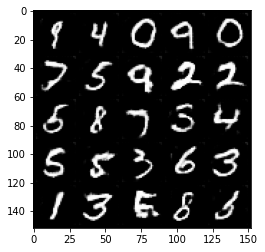

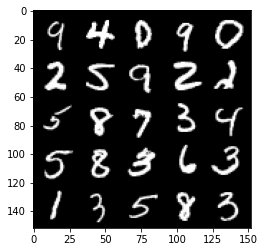

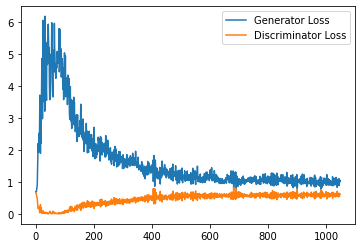

Epoch 45, step 21500: Generator loss: 1.0423645174503327, discriminator loss: 0.6087450425028801


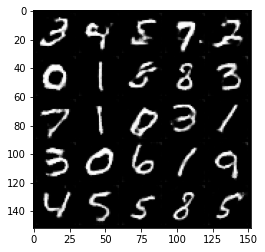

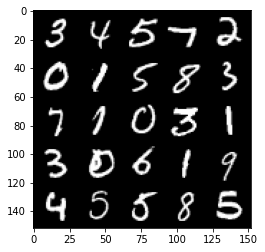

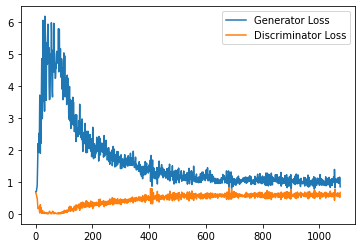

Epoch 46, step 22000: Generator loss: 0.9942814909219742, discriminator loss: 0.5998807944655419


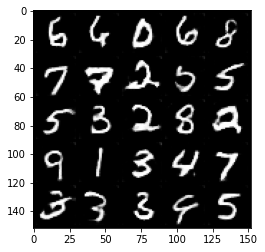

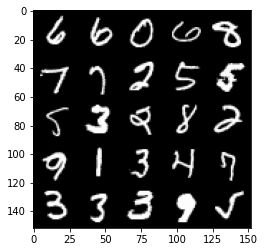

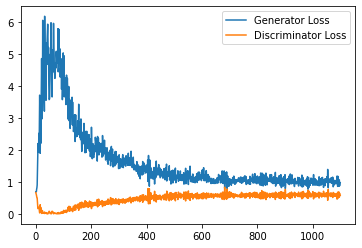

Epoch 47, step 22500: Generator loss: 0.9854967892169952, discriminator loss: 0.5986484294533729


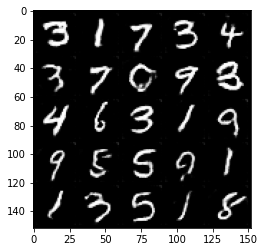

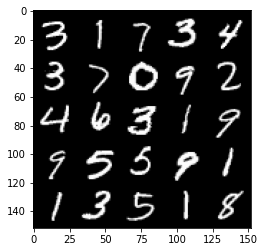

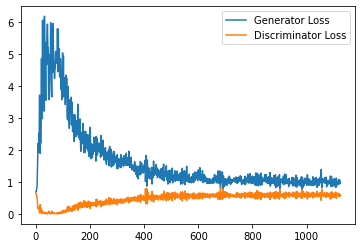

Epoch 49, step 23000: Generator loss: 1.0287623069286347, discriminator loss: 0.6007745735645295


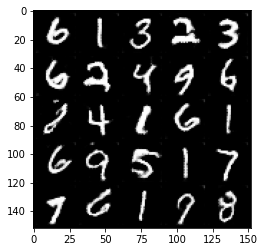

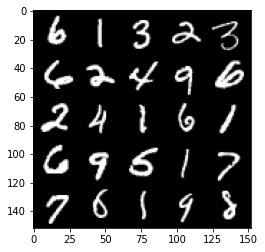

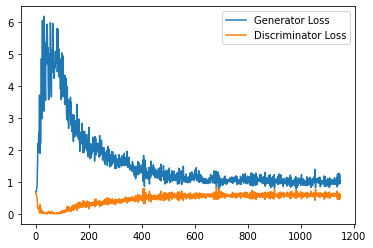

Epoch 50, step 23500: Generator loss: 0.981914914727211, discriminator loss: 0.6020895035862923


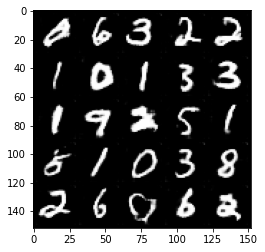

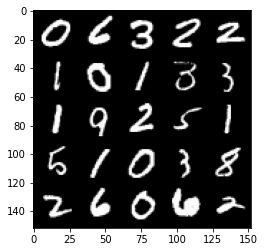

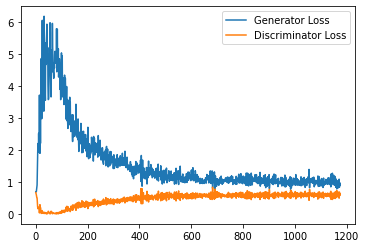

Epoch 51, step 24000: Generator loss: 0.9865739526748657, discriminator loss: 0.5967154186964035


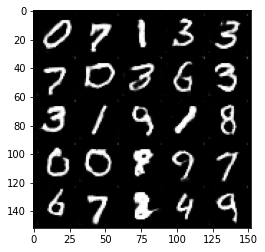

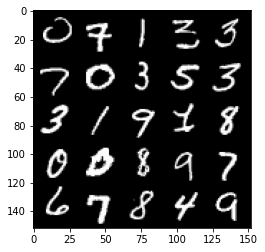

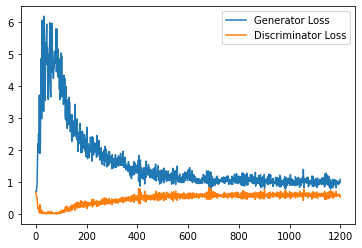

Epoch 52, step 24500: Generator loss: 0.9820247101783752, discriminator loss: 0.6059688193798065


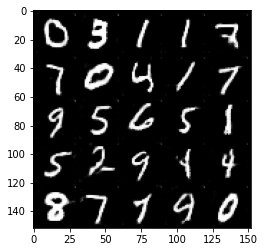

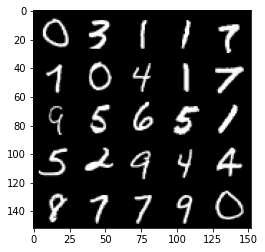

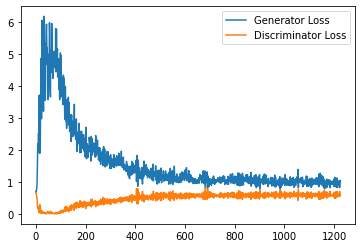

Epoch 53, step 25000: Generator loss: 0.97492171895504, discriminator loss: 0.601779217004776


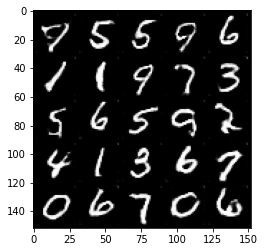

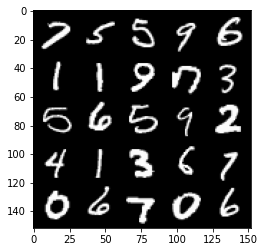

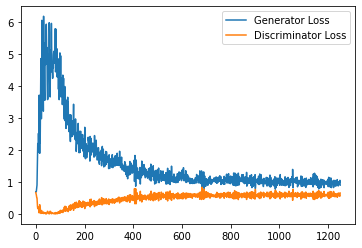

Epoch 54, step 25500: Generator loss: 1.0014057103395462, discriminator loss: 0.6052579741477966


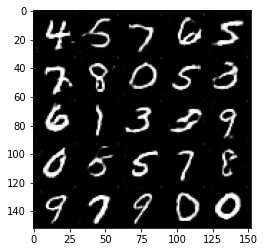

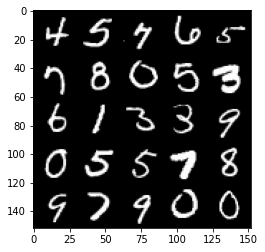

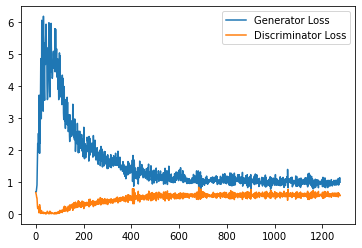

Epoch 55, step 26000: Generator loss: 0.9987071084976197, discriminator loss: 0.6071532557606697


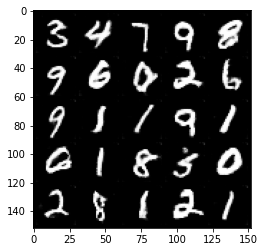

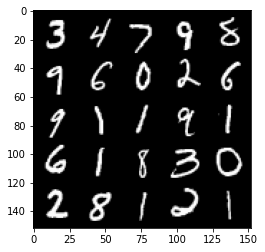

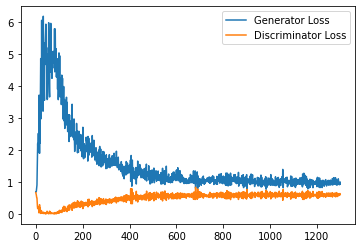

Epoch 56, step 26500: Generator loss: 0.961604276061058, discriminator loss: 0.6069531895518303


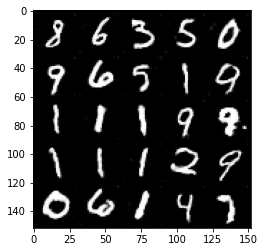

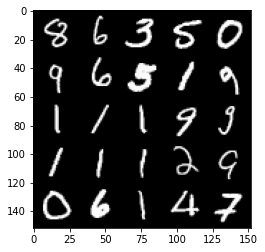

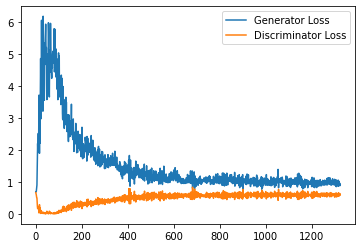

Epoch 57, step 27000: Generator loss: 0.9563802773952484, discriminator loss: 0.6055400129556656


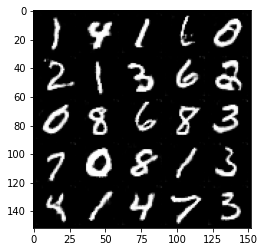

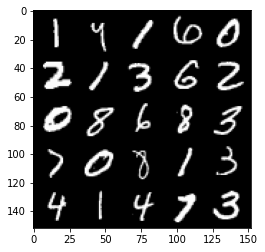

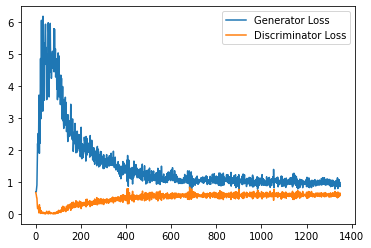

Epoch 58, step 27500: Generator loss: 0.9582283118963242, discriminator loss: 0.6158555659651757


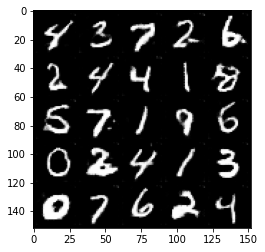

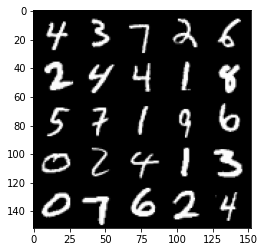

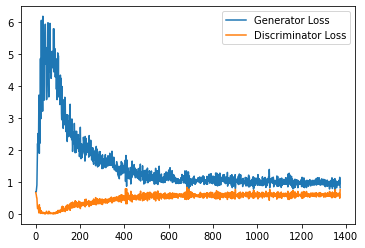

Epoch 59, step 28000: Generator loss: 0.9958573945760727, discriminator loss: 0.6047795162200927


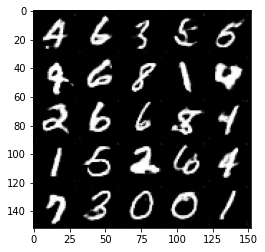

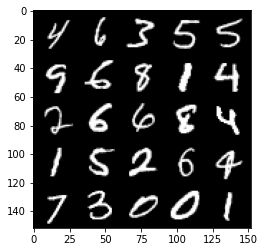

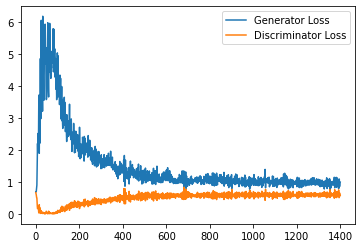

Epoch 60, step 28500: Generator loss: 0.9574192513227463, discriminator loss: 0.6130654337406158


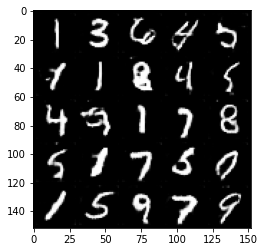

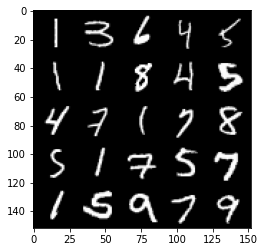

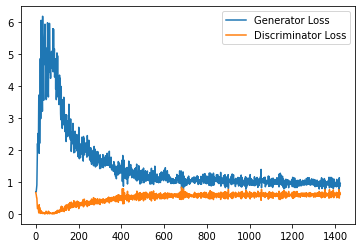

Epoch 61, step 29000: Generator loss: 0.9513714807033539, discriminator loss: 0.60991746032238


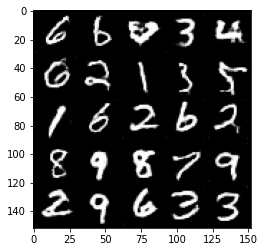

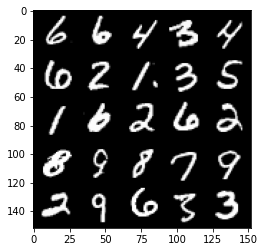

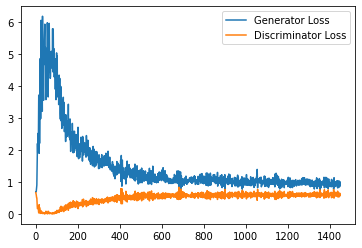

Epoch 62, step 29500: Generator loss: 0.9495181388854981, discriminator loss: 0.6079605092406273


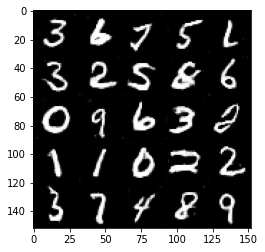

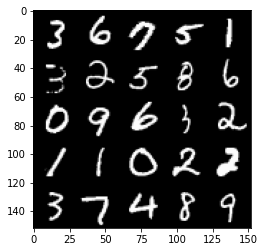

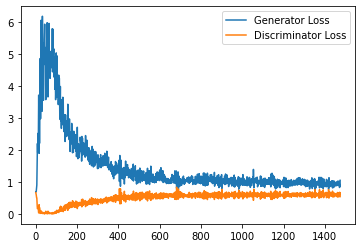

Epoch 63, step 30000: Generator loss: 0.952762048125267, discriminator loss: 0.6121077378988266


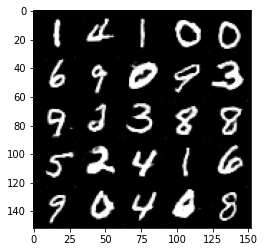

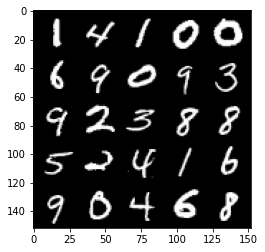

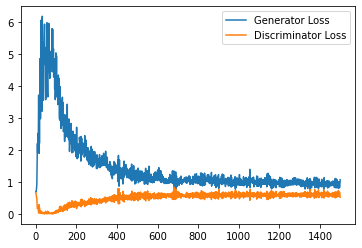

Epoch 65, step 30500: Generator loss: 0.9359541709423065, discriminator loss: 0.6111844326257706


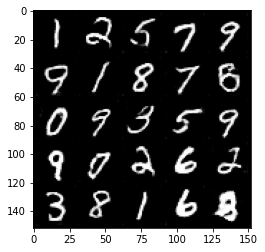

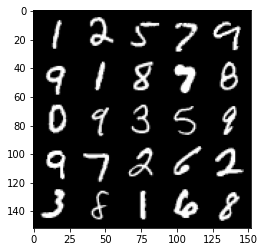

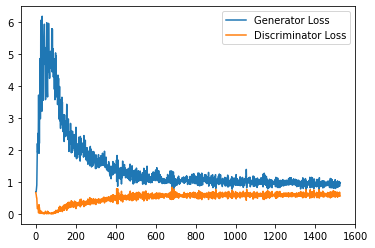

Epoch 66, step 31000: Generator loss: 0.9529678223133087, discriminator loss: 0.6108976624011994


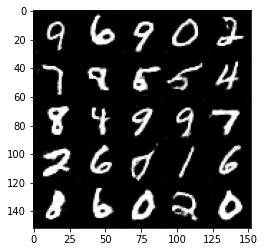

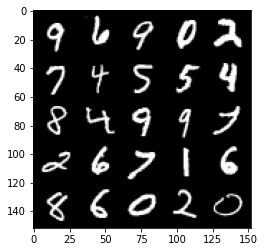

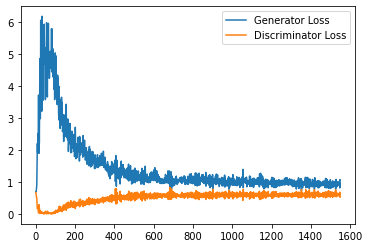

Epoch 67, step 31500: Generator loss: 0.9377904800176621, discriminator loss: 0.6149189132452011


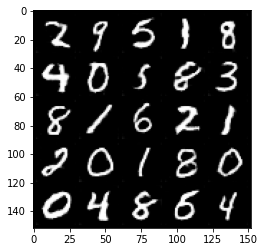

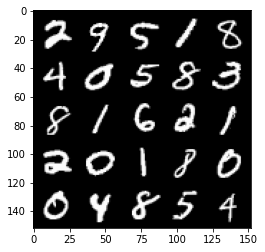

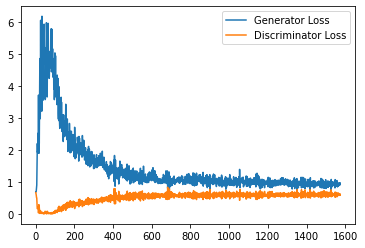

Epoch 68, step 32000: Generator loss: 0.9344630260467529, discriminator loss: 0.6146269282698631


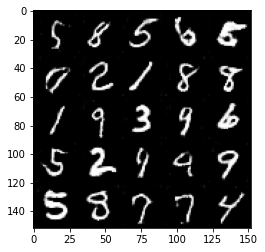

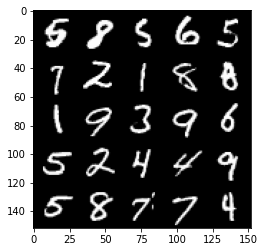

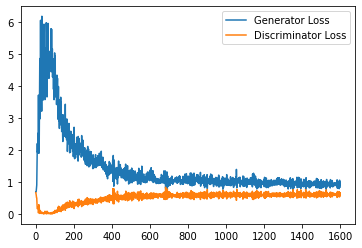

Epoch 69, step 32500: Generator loss: 0.9434100185632706, discriminator loss: 0.6125144068598747


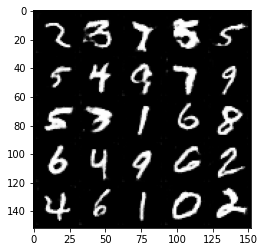

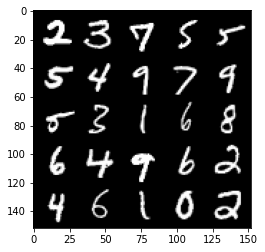

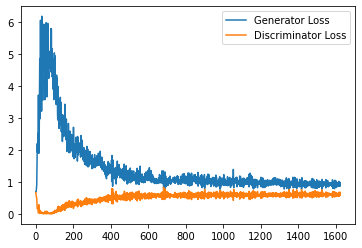

Epoch 70, step 33000: Generator loss: 0.9397251515388488, discriminator loss: 0.6112299975156784


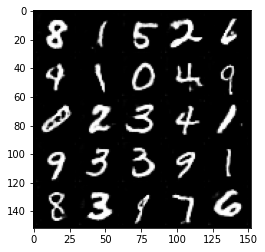

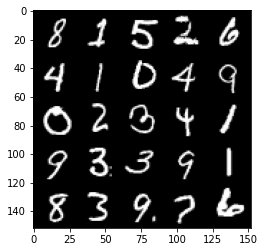

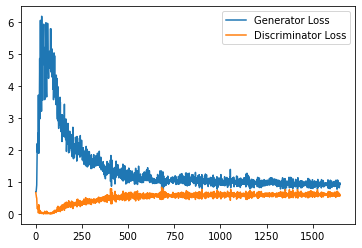

Epoch 71, step 33500: Generator loss: 0.9208567969799042, discriminator loss: 0.6141707223057747


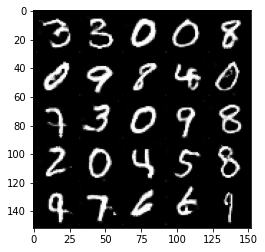

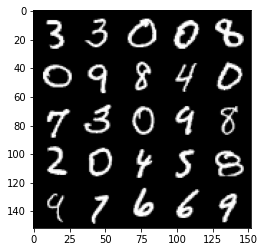

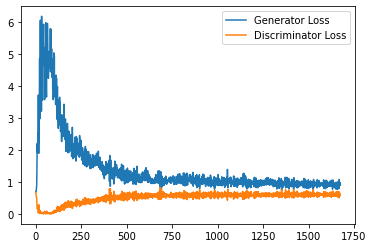

Epoch 72, step 34000: Generator loss: 0.9476676412820816, discriminator loss: 0.6185534535646439


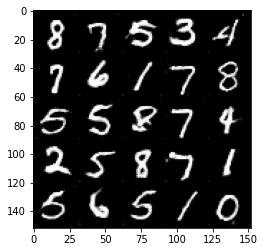

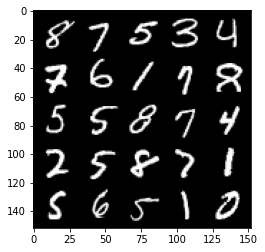

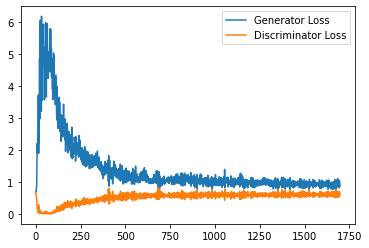

Epoch 73, step 34500: Generator loss: 0.9243094067573547, discriminator loss: 0.6153358955383301


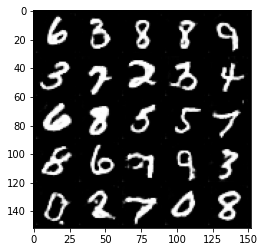

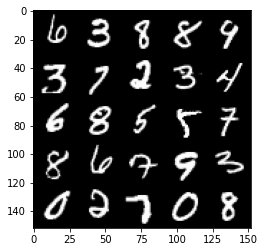

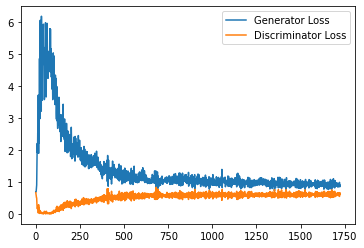

Epoch 74, step 35000: Generator loss: 0.9282827317714691, discriminator loss: 0.6122176452279091


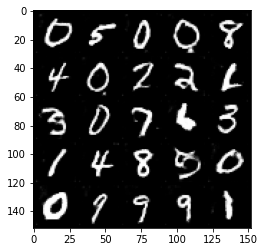

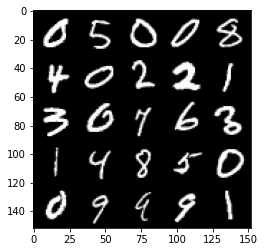

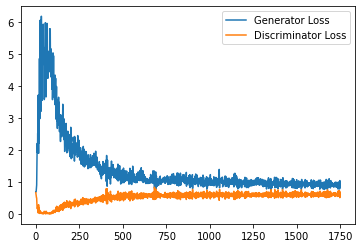

Epoch 75, step 35500: Generator loss: 0.9403334176540374, discriminator loss: 0.6178642539381981


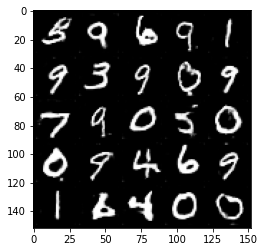

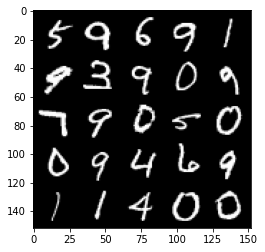

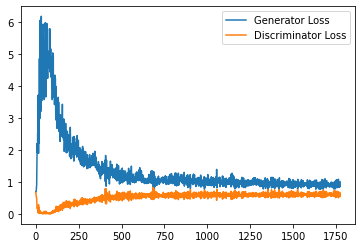

Epoch 76, step 36000: Generator loss: 0.9169300857782364, discriminator loss: 0.615209058701992


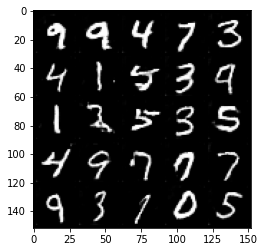

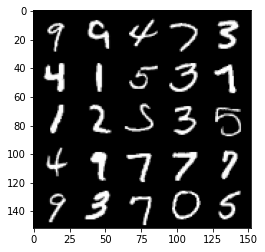

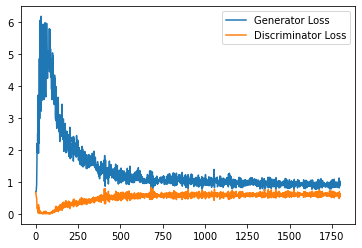

Epoch 77, step 36500: Generator loss: 0.9407890167236328, discriminator loss: 0.6173534377217292


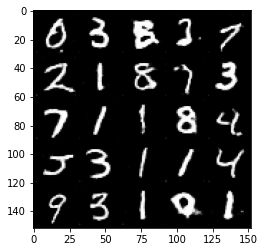

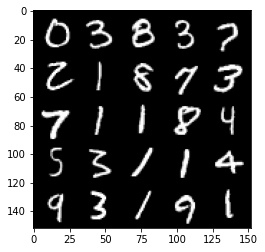

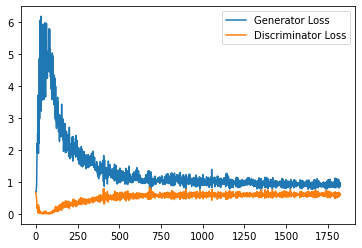

Epoch 78, step 37000: Generator loss: 0.9533132115602493, discriminator loss: 0.6144310193061828


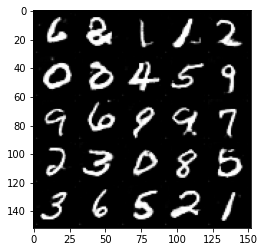

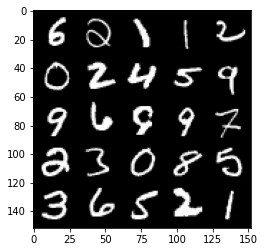

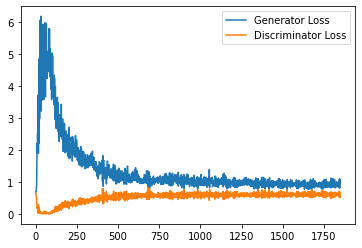

Epoch 79, step 37500: Generator loss: 0.9488725154399872, discriminator loss: 0.6191076827645302


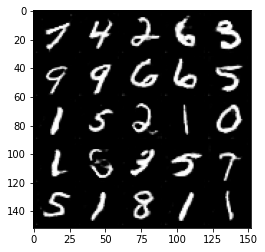

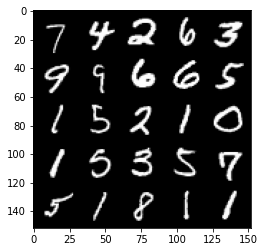

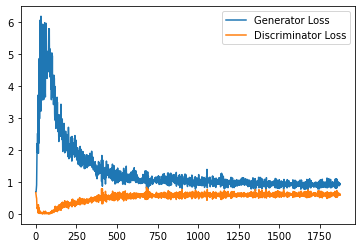

Epoch 81, step 38000: Generator loss: 0.9295310369729995, discriminator loss: 0.6150091611742974


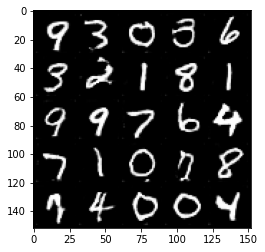

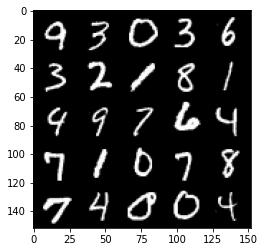

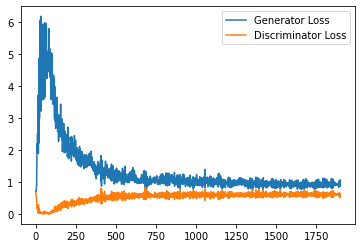

Epoch 82, step 38500: Generator loss: 0.9579441065788269, discriminator loss: 0.6213668576478958


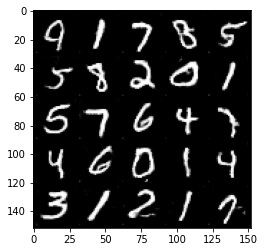

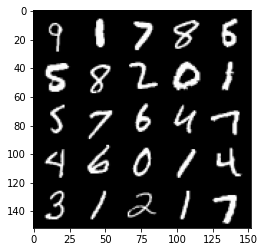

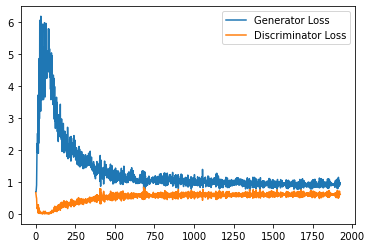

Epoch 83, step 39000: Generator loss: 0.9328471720218658, discriminator loss: 0.6199031374454498


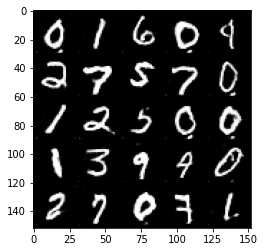

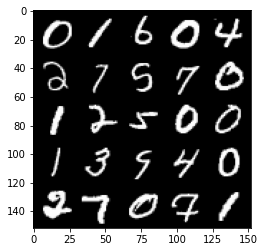

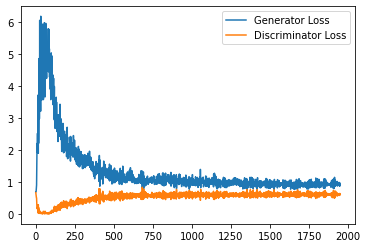

Epoch 84, step 39500: Generator loss: 0.9325839866399765, discriminator loss: 0.6184983983635902


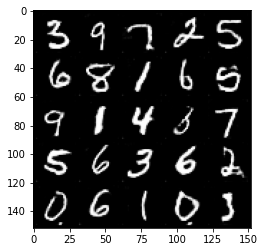

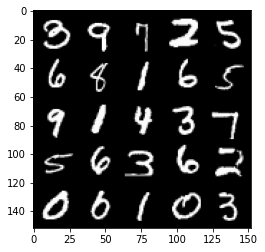

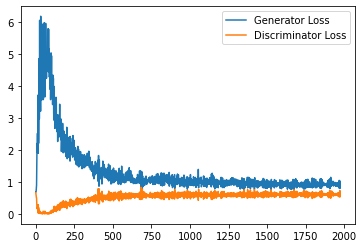

Epoch 85, step 40000: Generator loss: 0.9345687365531922, discriminator loss: 0.6213440678119659


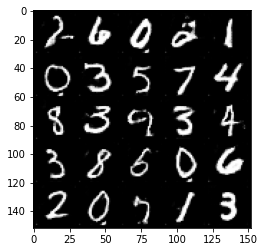

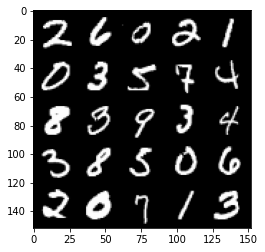

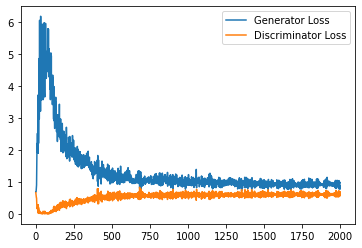

Epoch 86, step 40500: Generator loss: 0.9193324574232101, discriminator loss: 0.6154345228672028


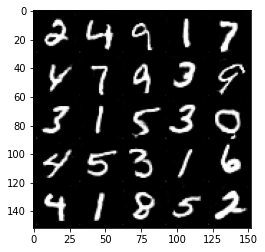

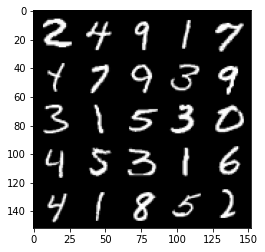

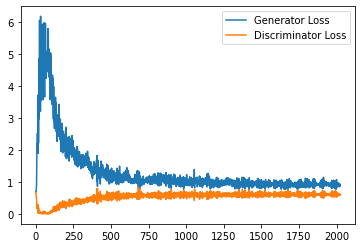

Epoch 87, step 41000: Generator loss: 0.9068502725362778, discriminator loss: 0.6214079026579857


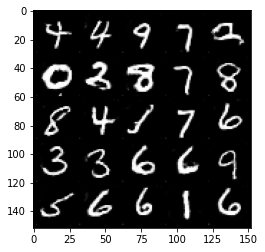

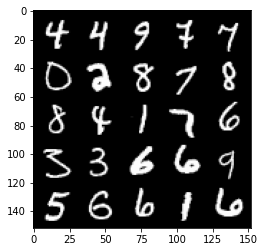

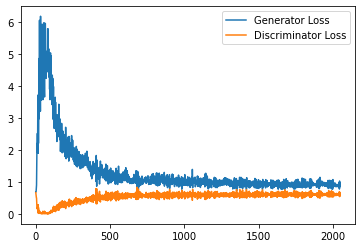

Epoch 88, step 41500: Generator loss: 0.9278785742521286, discriminator loss: 0.6176280787587166


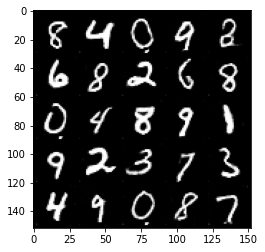

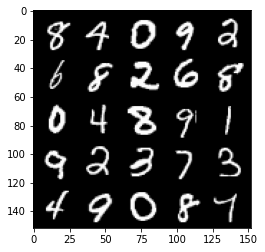

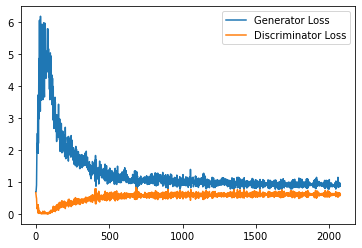

Epoch 89, step 42000: Generator loss: 0.9425362617969513, discriminator loss: 0.6182059925794602


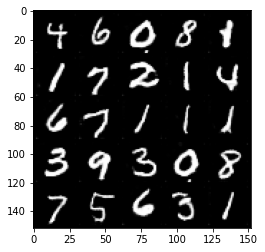

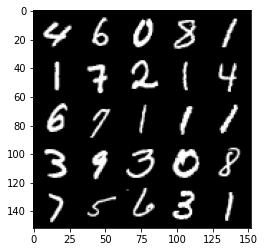

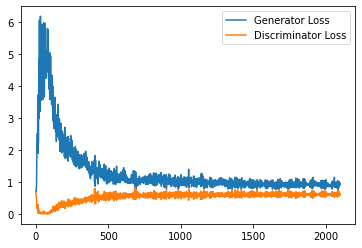

Epoch 90, step 42500: Generator loss: 0.9281834903955459, discriminator loss: 0.6201703417897224


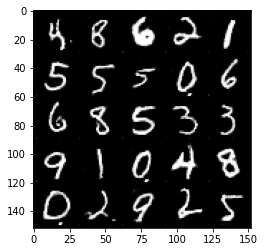

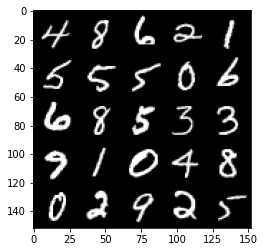

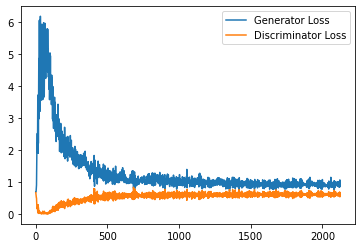

Epoch 91, step 43000: Generator loss: 0.9252097653150558, discriminator loss: 0.6171151928901673


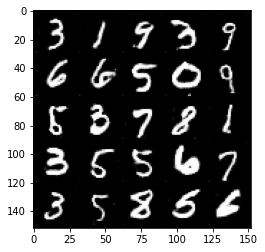

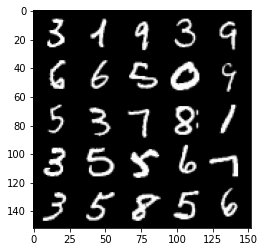

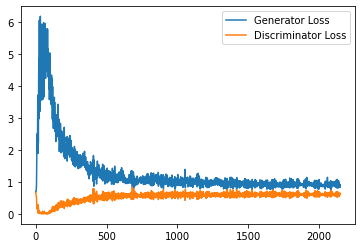

Epoch 92, step 43500: Generator loss: 0.9198412650823593, discriminator loss: 0.6185888921022415


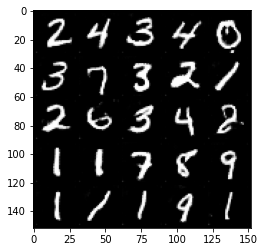

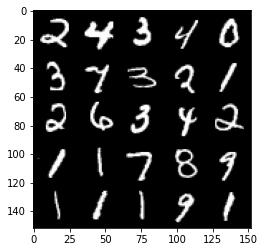

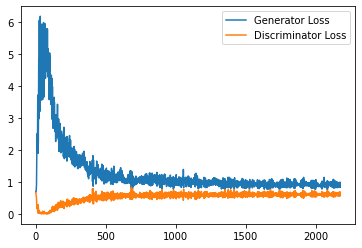

Epoch 93, step 44000: Generator loss: 0.9551509681940079, discriminator loss: 0.6166757014393807


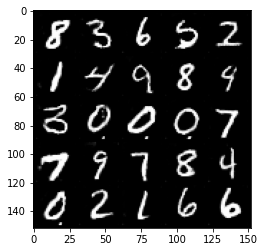

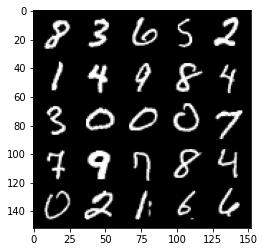

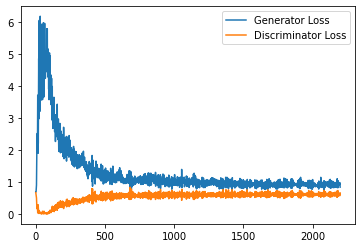

Epoch 94, step 44500: Generator loss: 0.9253214955329895, discriminator loss: 0.6143649696111679


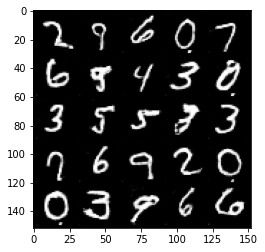

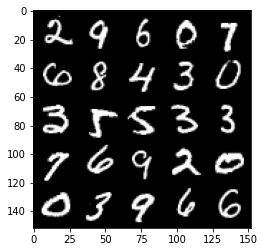

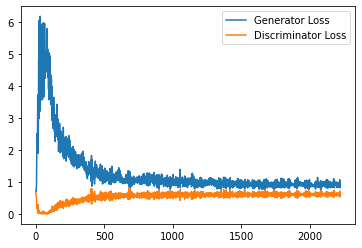

Epoch 95, step 45000: Generator loss: 0.9315404505729675, discriminator loss: 0.6159754944443703


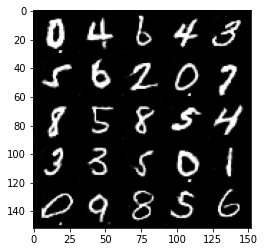

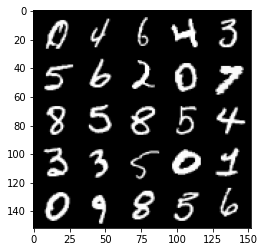

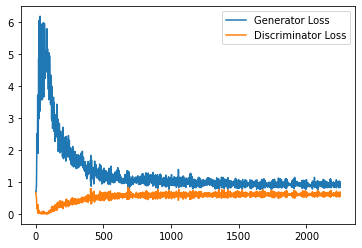

Epoch 97, step 45500: Generator loss: 0.9471585576534272, discriminator loss: 0.6165997297763824


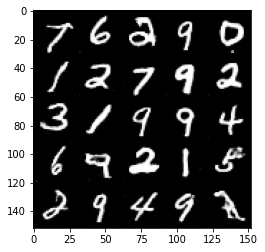

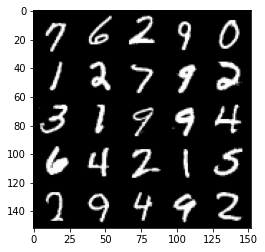

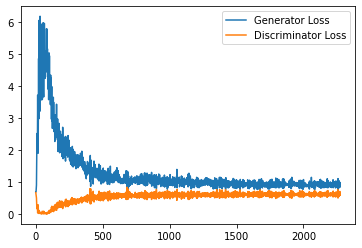

Epoch 98, step 46000: Generator loss: 0.9218440687656403, discriminator loss: 0.6172209639549255


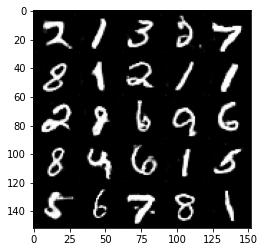

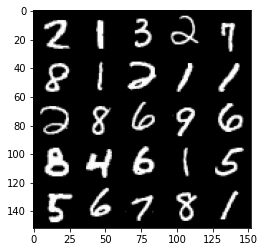

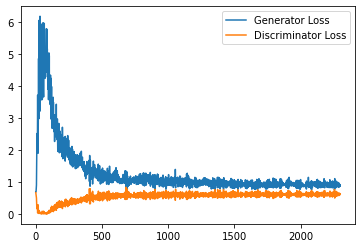

Epoch 99, step 46500: Generator loss: 0.909875873208046, discriminator loss: 0.6150692085027695


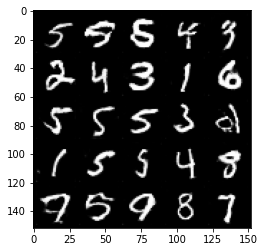

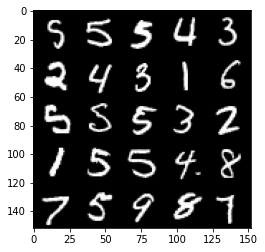

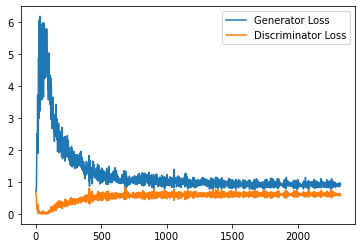

Epoch 100, step 47000: Generator loss: 0.9543448166847229, discriminator loss: 0.6148699650168419


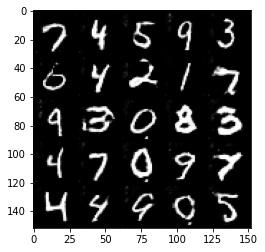

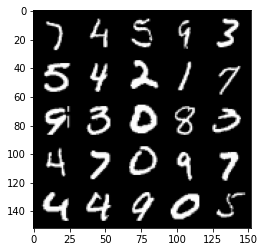

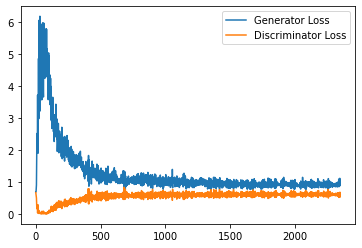

Epoch 101, step 47500: Generator loss: 0.9369126675128937, discriminator loss: 0.6209549738168716


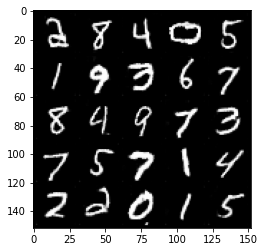

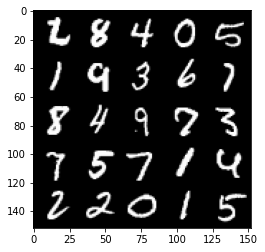

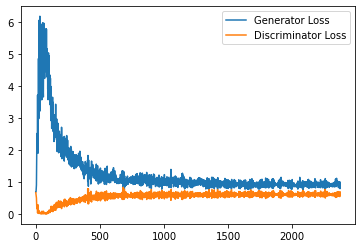

Epoch 102, step 48000: Generator loss: 0.9378577055931091, discriminator loss: 0.6132594501972198


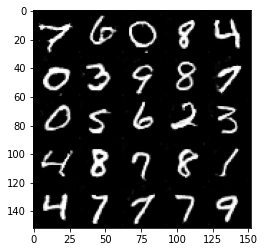

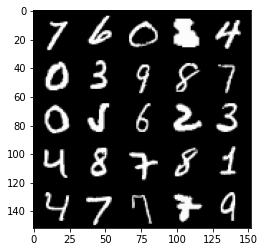

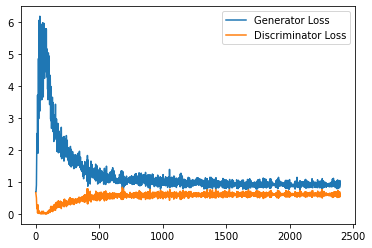

Epoch 103, step 48500: Generator loss: 0.928516193151474, discriminator loss: 0.6183466975688934


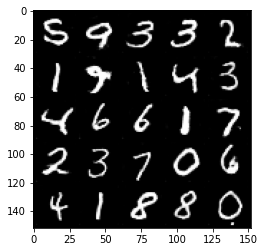

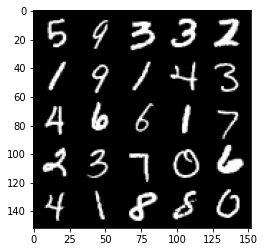

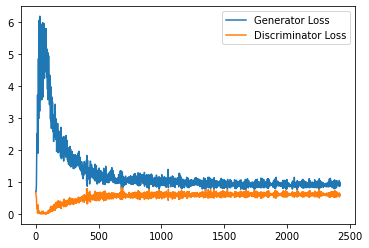

Epoch 104, step 49000: Generator loss: 0.9245964806079865, discriminator loss: 0.6193631387352944


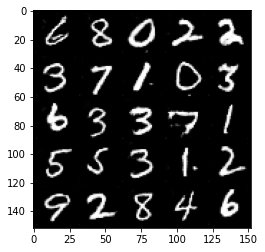

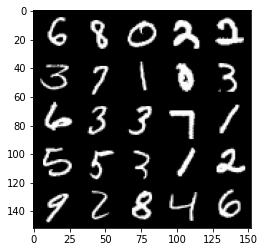

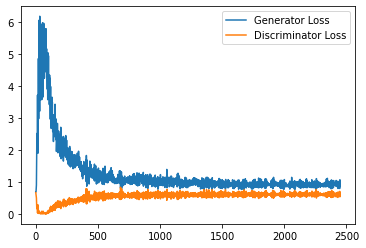

Epoch 105, step 49500: Generator loss: 0.9342759296894073, discriminator loss: 0.6127177296876908


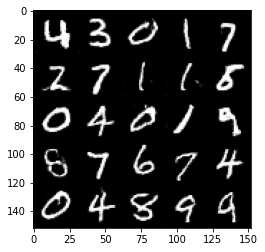

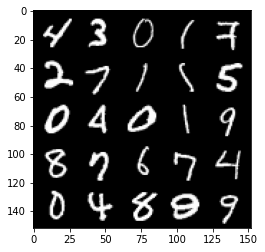

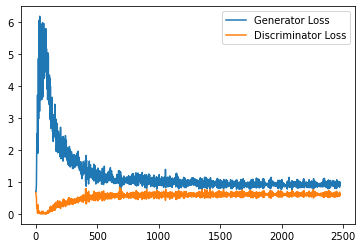

Epoch 106, step 50000: Generator loss: 0.934841558098793, discriminator loss: 0.6160513432025909


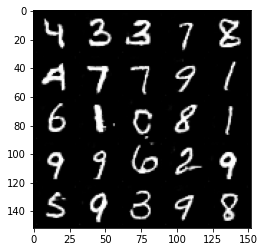

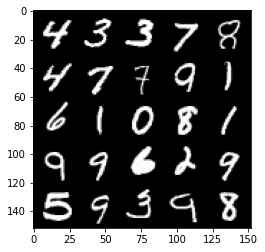

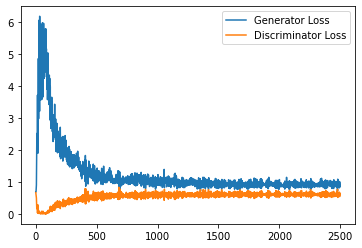

Epoch 107, step 50500: Generator loss: 0.9429825568199157, discriminator loss: 0.6119438753128051


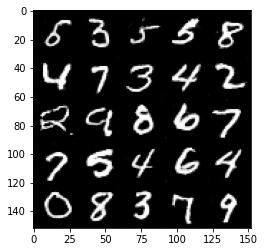

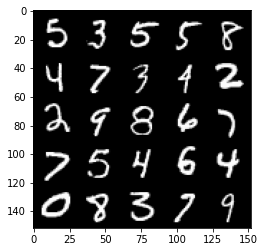

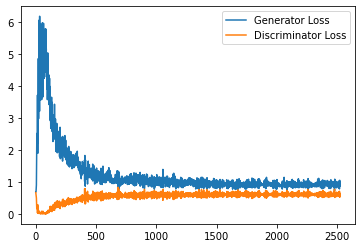

Epoch 108, step 51000: Generator loss: 0.9426879032850265, discriminator loss: 0.616886238694191


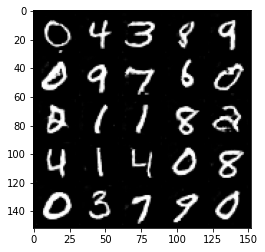

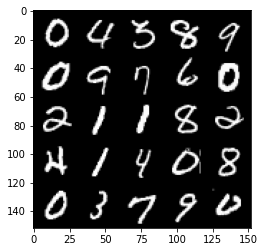

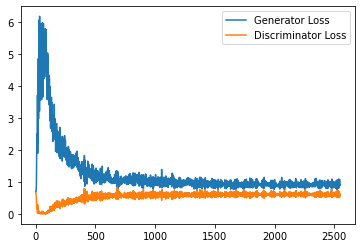

Epoch 109, step 51500: Generator loss: 0.9182683875560761, discriminator loss: 0.6154120222330094


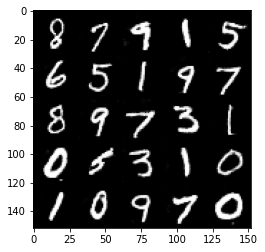

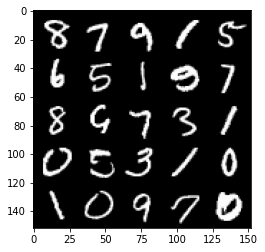

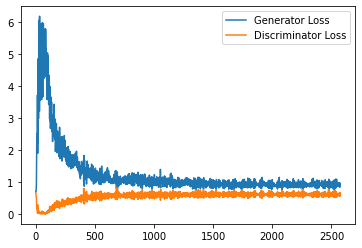

Epoch 110, step 52000: Generator loss: 0.9539770172834396, discriminator loss: 0.6104093802571297


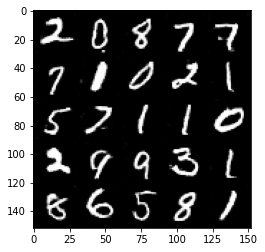

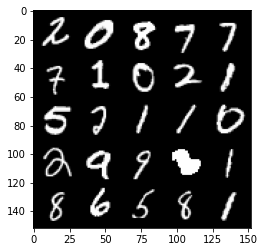

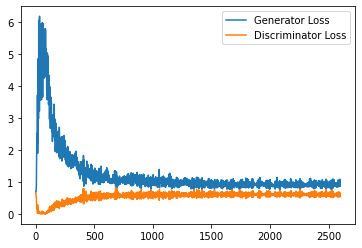

Epoch 111, step 52500: Generator loss: 0.9435370061397552, discriminator loss: 0.6162705550789833


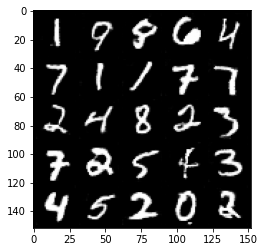

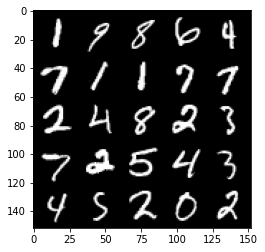

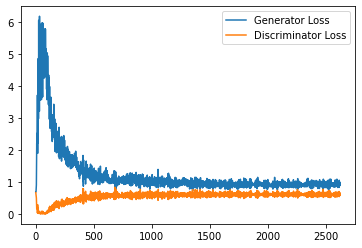

Epoch 113, step 53000: Generator loss: 0.9347068157196045, discriminator loss: 0.614006242275238


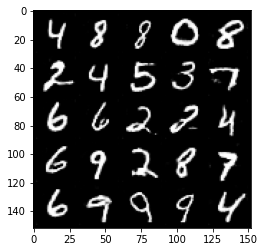

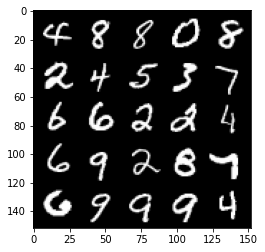

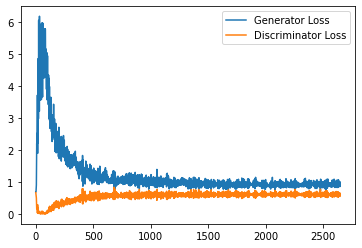

Epoch 114, step 53500: Generator loss: 0.9411601380109788, discriminator loss: 0.6125806301236153


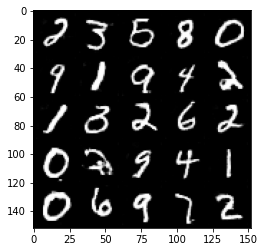

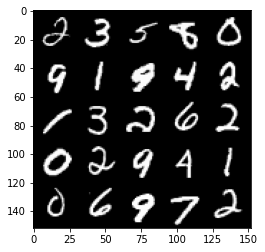

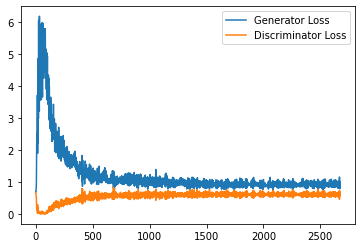

Epoch 115, step 54000: Generator loss: 0.9299645799398423, discriminator loss: 0.6110391218662262


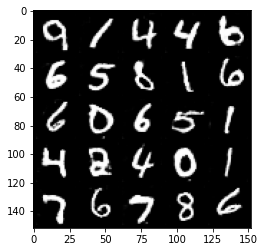

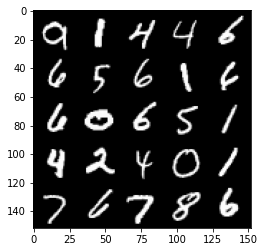

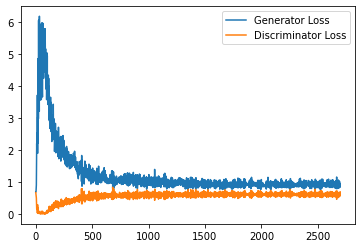

Epoch 116, step 54500: Generator loss: 0.944531390786171, discriminator loss: 0.6129093403220177


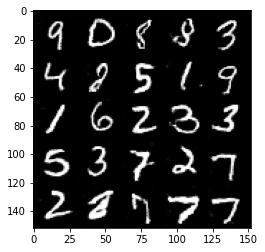

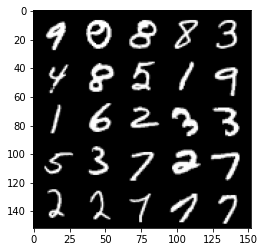

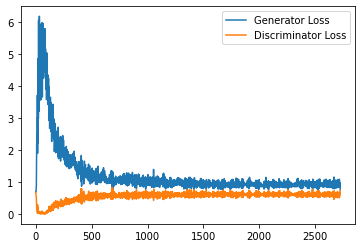

Epoch 117, step 55000: Generator loss: 0.9470594066381455, discriminator loss: 0.6070958218574524


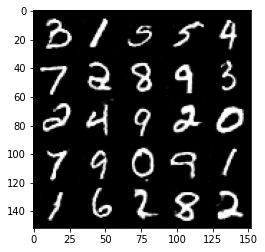

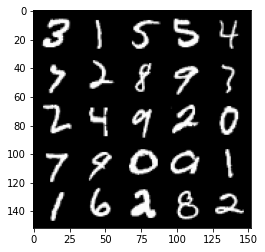

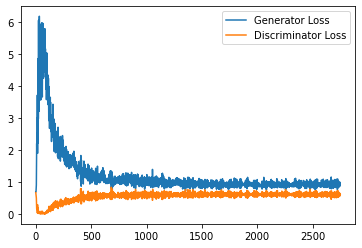

Epoch 118, step 55500: Generator loss: 0.9399305806159973, discriminator loss: 0.6056319768428803


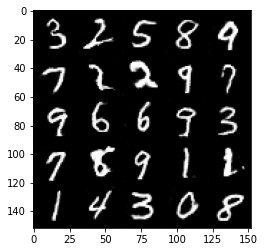

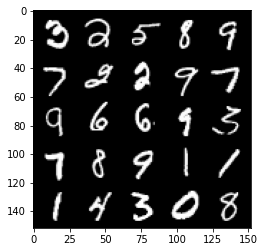

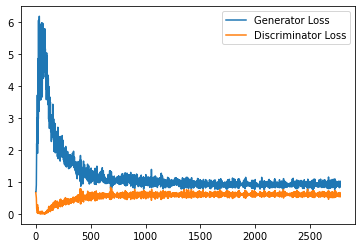

Epoch 119, step 56000: Generator loss: 0.9793863226175308, discriminator loss: 0.6026828574538231


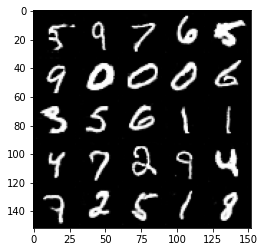

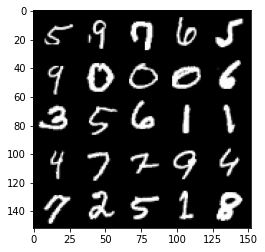

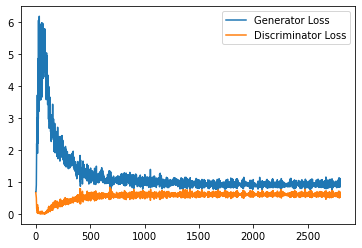

Epoch 120, step 56500: Generator loss: 0.9433492895364761, discriminator loss: 0.6093830983638764


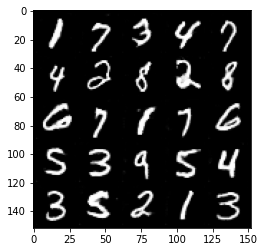

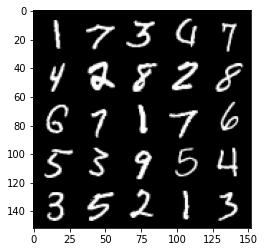

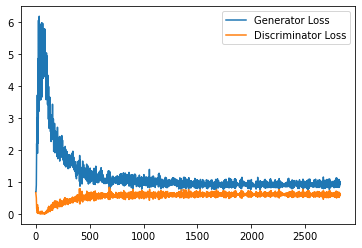

Epoch 121, step 57000: Generator loss: 0.9395574328899383, discriminator loss: 0.6073991407752037


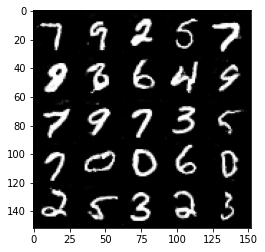

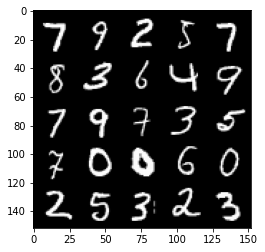

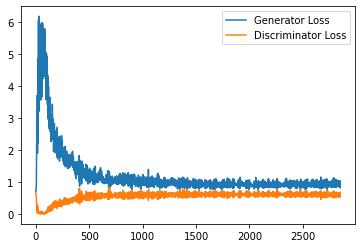

Epoch 122, step 57500: Generator loss: 0.969034191608429, discriminator loss: 0.6020204185843467


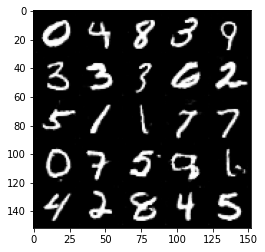

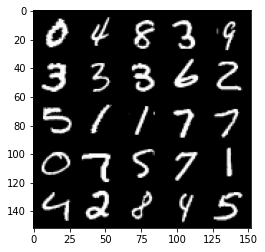

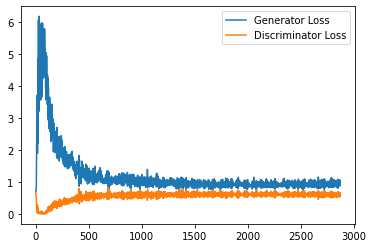

Epoch 123, step 58000: Generator loss: 0.9762199646234513, discriminator loss: 0.6036548998951912


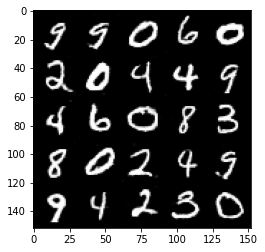

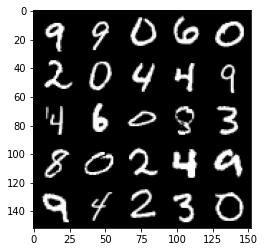

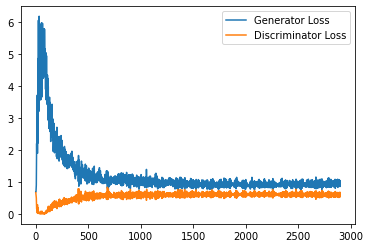

Epoch 124, step 58500: Generator loss: 0.9544413760900498, discriminator loss: 0.5996513844132424


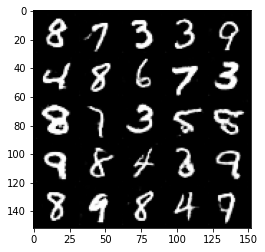

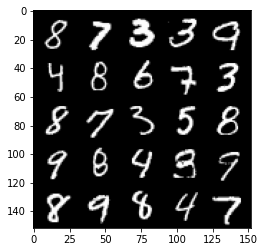

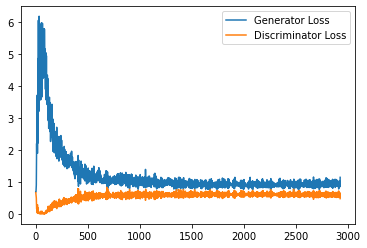

Epoch 125, step 59000: Generator loss: 0.96137617623806, discriminator loss: 0.6017300159335136


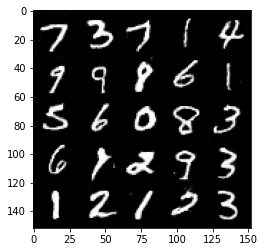

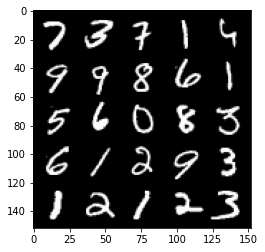

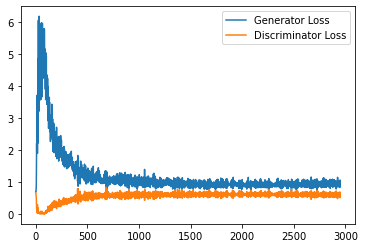

Epoch 126, step 59500: Generator loss: 0.9879900784492492, discriminator loss: 0.5996590792536736


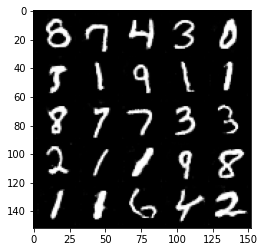

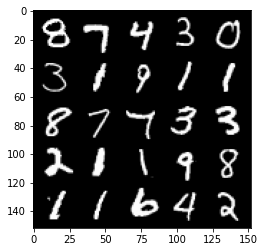

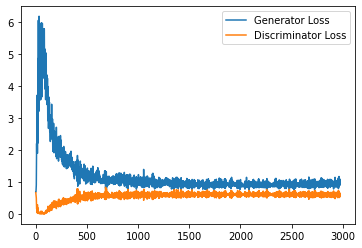

Epoch 127, step 60000: Generator loss: 0.9816397840976715, discriminator loss: 0.5982072867751121


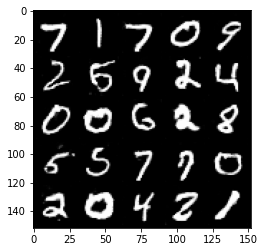

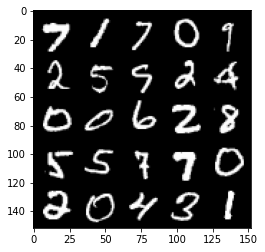

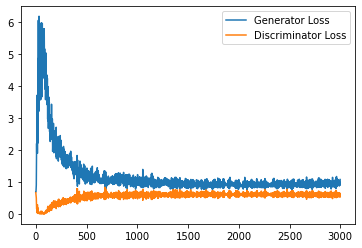

Epoch 128, step 60500: Generator loss: 0.9725999978780746, discriminator loss: 0.6001970447897911


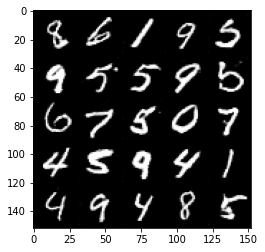

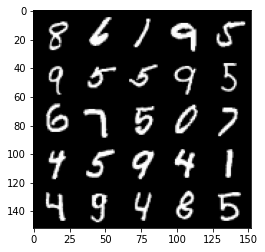

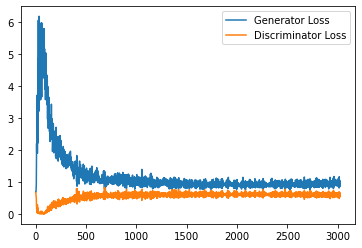

Epoch 130, step 61000: Generator loss: 0.9788119202852249, discriminator loss: 0.5944881057739257


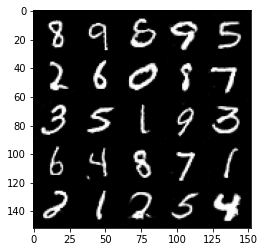

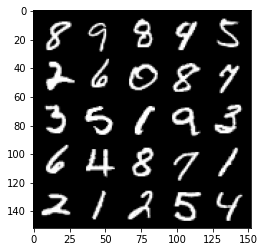

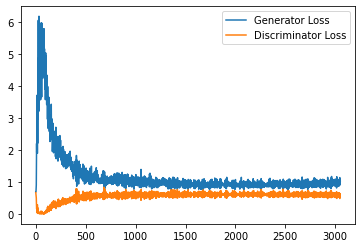

Epoch 131, step 61500: Generator loss: 0.9734150211811066, discriminator loss: 0.6044126729369164


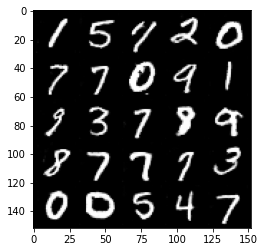

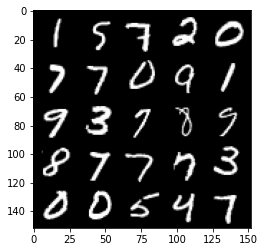

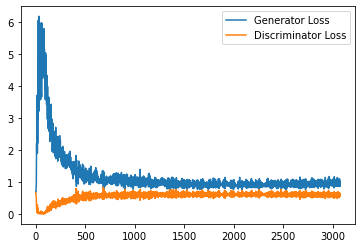

Epoch 132, step 62000: Generator loss: 0.9935078637599946, discriminator loss: 0.5960389621257782


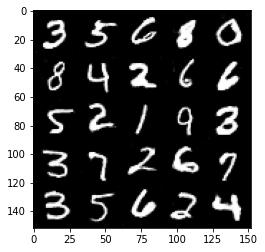

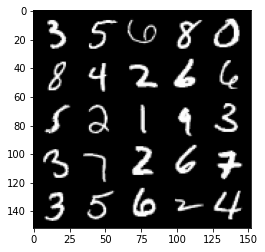

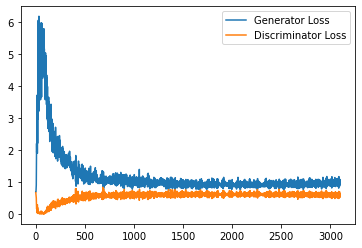

Epoch 133, step 62500: Generator loss: 0.9635636084079743, discriminator loss: 0.5990322098731995


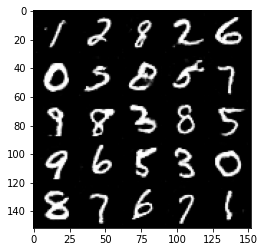

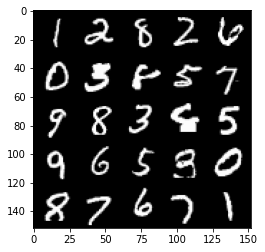

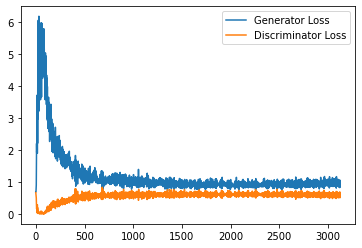

Epoch 134, step 63000: Generator loss: 0.9659678176641464, discriminator loss: 0.600053593158722


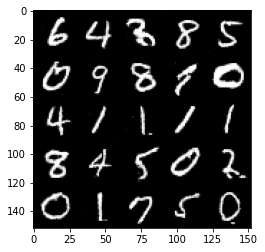

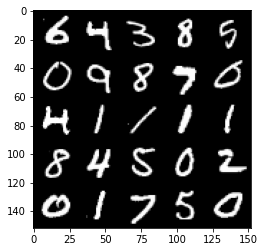

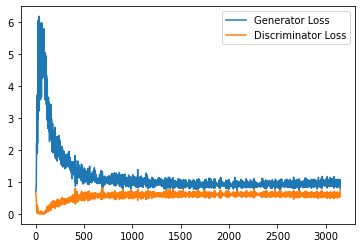

Epoch 135, step 63500: Generator loss: 0.9977234592437744, discriminator loss: 0.5930532892942428


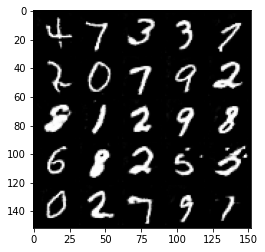

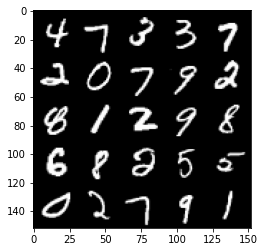

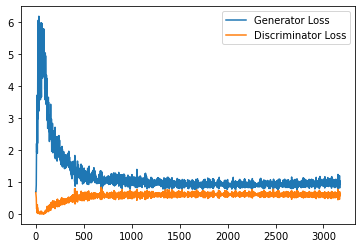

Epoch 136, step 64000: Generator loss: 0.9840098563432693, discriminator loss: 0.5937790475487709


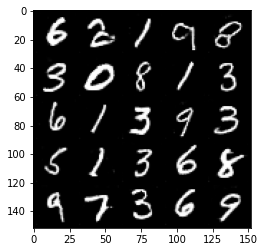

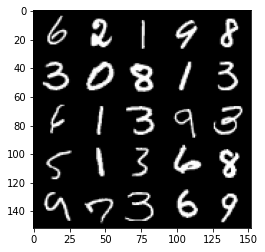

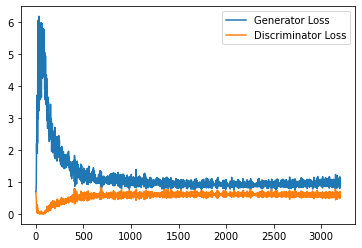

Epoch 137, step 64500: Generator loss: 0.9911173666715622, discriminator loss: 0.5911826492547989


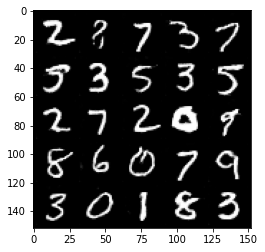

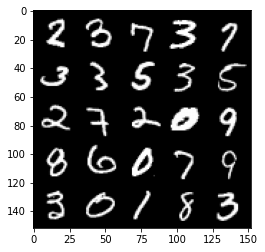

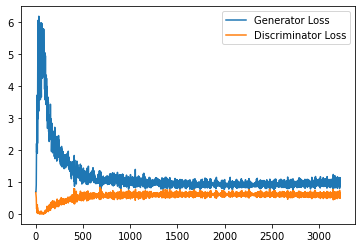

Epoch 138, step 65000: Generator loss: 0.9805174570083618, discriminator loss: 0.5962413412928581


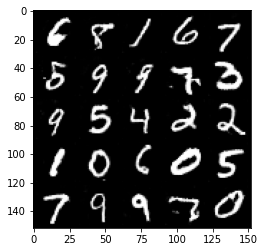

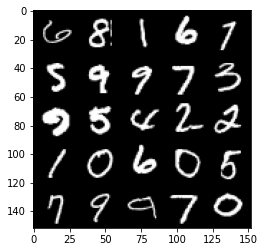

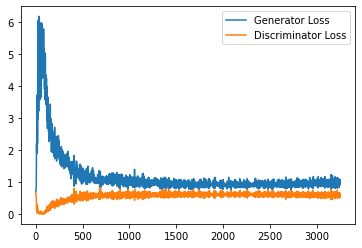

Epoch 139, step 65500: Generator loss: 0.9916407736539841, discriminator loss: 0.5905755174160003


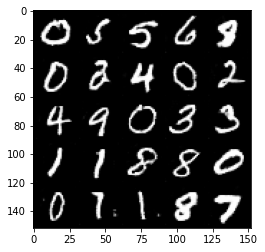

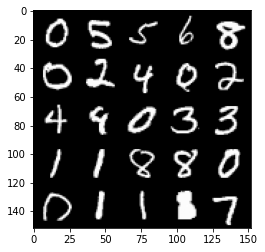

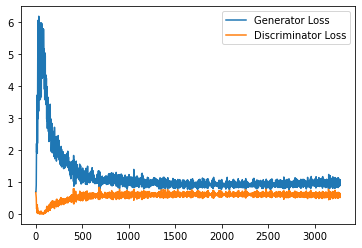

Epoch 140, step 66000: Generator loss: 0.9876984306573868, discriminator loss: 0.5939195799827576


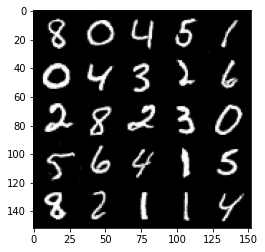

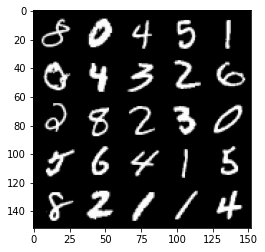

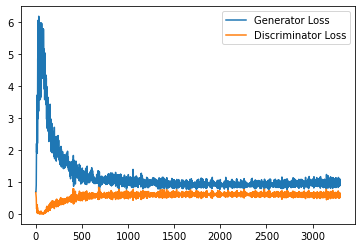

Epoch 141, step 66500: Generator loss: 0.9856588551998139, discriminator loss: 0.5946693007946015


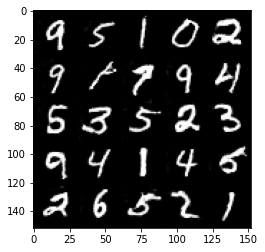

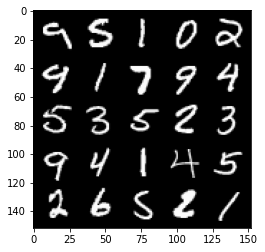

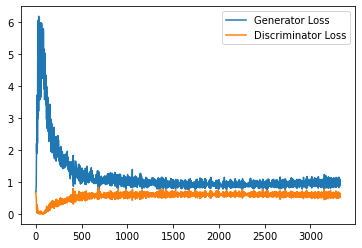

Epoch 142, step 67000: Generator loss: 0.9829056602716446, discriminator loss: 0.5886969708800316


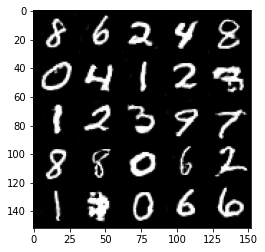

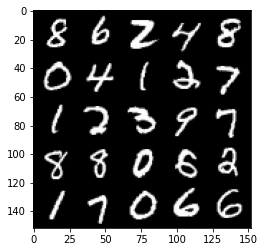

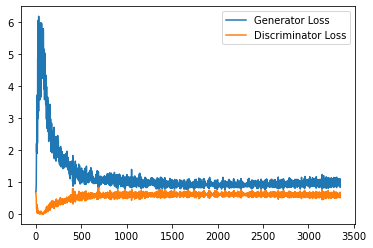

Epoch 143, step 67500: Generator loss: 0.9960052055120469, discriminator loss: 0.5904038736820221


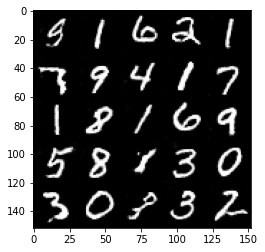

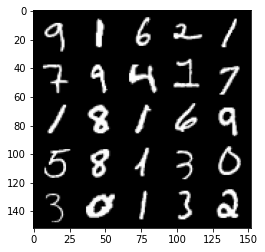

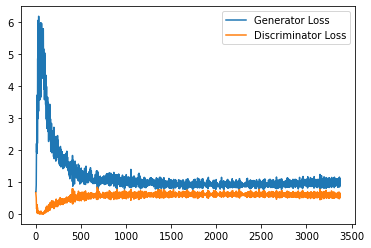

Epoch 144, step 68000: Generator loss: 0.9869610211849212, discriminator loss: 0.5903259882330895


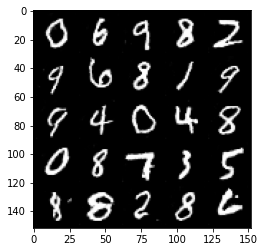

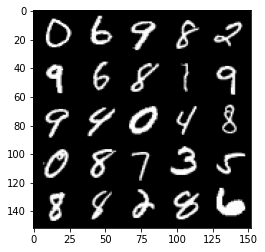

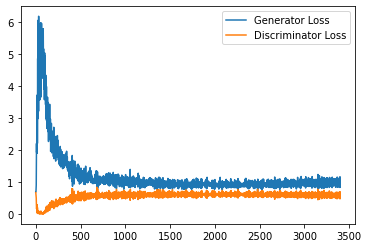

Epoch 146, step 68500: Generator loss: 1.0137779940366745, discriminator loss: 0.5841812183260917


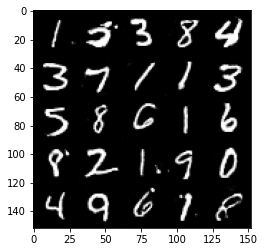

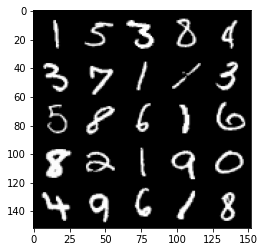

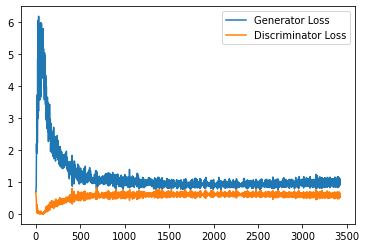

Epoch 147, step 69000: Generator loss: 1.0099110914468765, discriminator loss: 0.5866913102269172


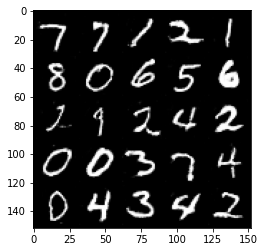

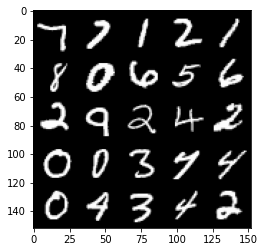

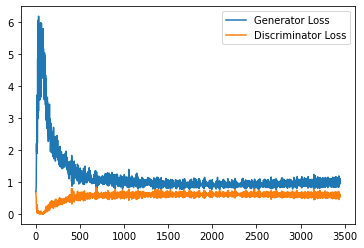

Epoch 148, step 69500: Generator loss: 1.0162780617475509, discriminator loss: 0.5840131612420082


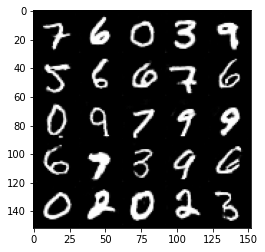

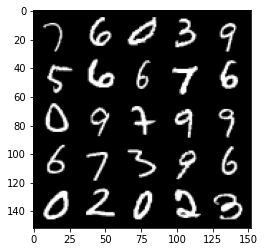

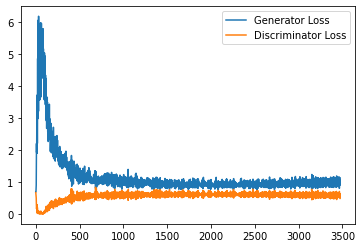

Epoch 149, step 70000: Generator loss: 1.0014056903123856, discriminator loss: 0.5816661468148232


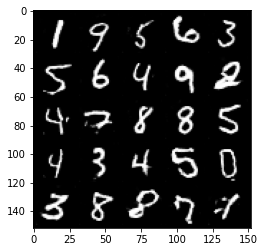

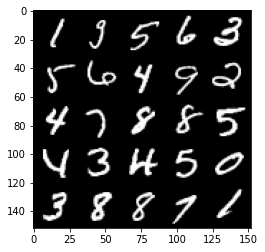

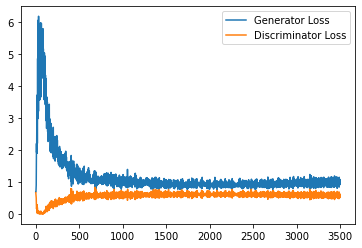

Epoch 150, step 70500: Generator loss: 1.0088381954431533, discriminator loss: 0.5857423079609871


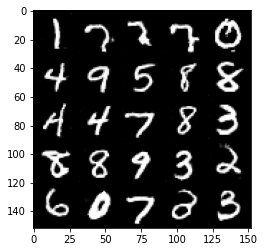

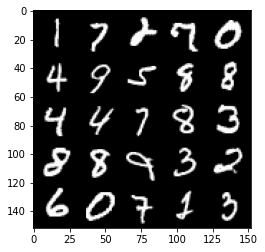

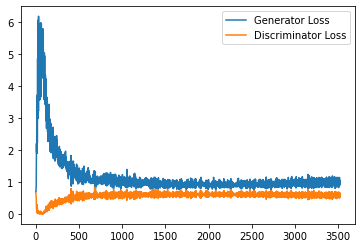

Epoch 151, step 71000: Generator loss: 1.0167265253067017, discriminator loss: 0.5826820028424263


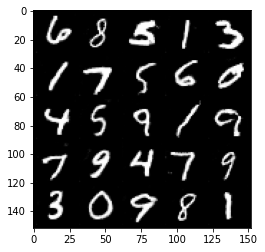

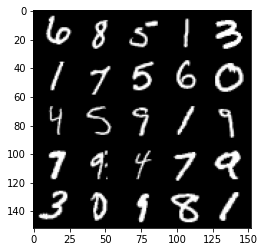

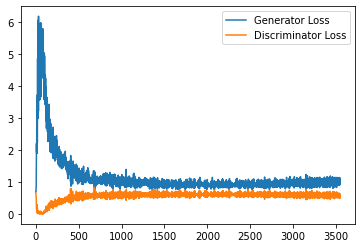

Epoch 152, step 71500: Generator loss: 1.014633347272873, discriminator loss: 0.584531966805458


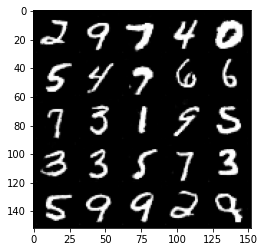

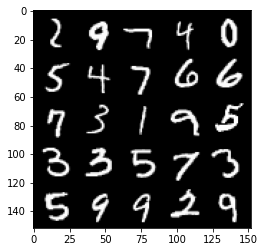

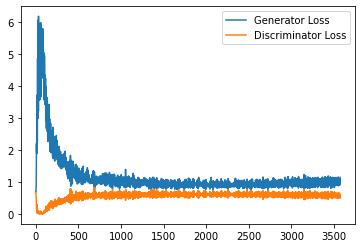

Epoch 153, step 72000: Generator loss: 1.0016107096672058, discriminator loss: 0.5863553803563119


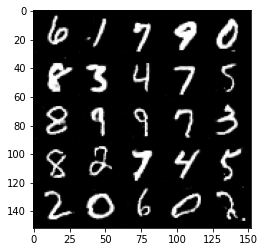

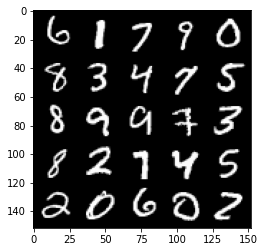

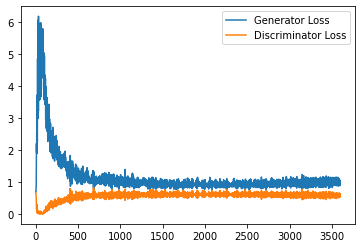

Epoch 154, step 72500: Generator loss: 1.0122905910015105, discriminator loss: 0.58324432939291


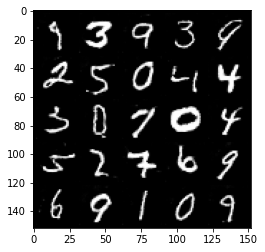

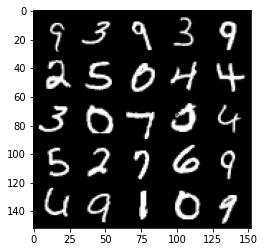

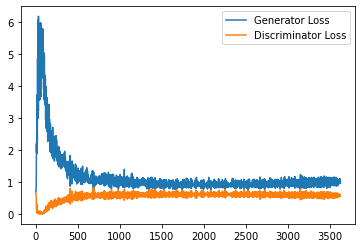

Epoch 155, step 73000: Generator loss: 1.0121155027151107, discriminator loss: 0.5859738181829452


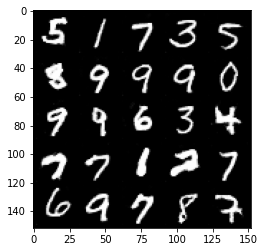

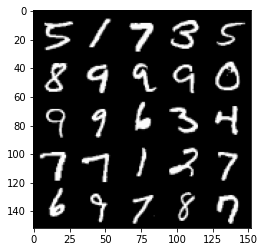

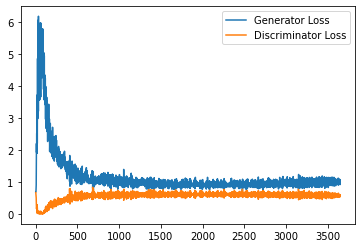

Epoch 156, step 73500: Generator loss: 1.0095202918052673, discriminator loss: 0.5834830892682076


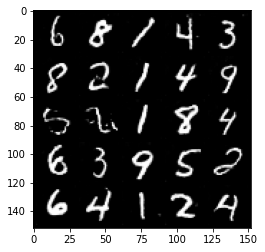

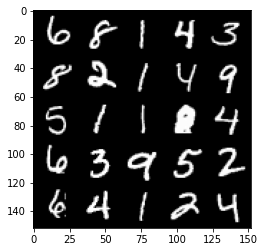

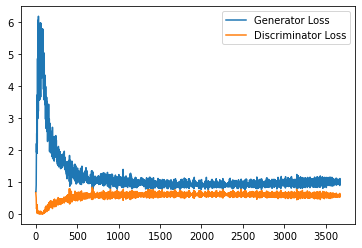

Epoch 157, step 74000: Generator loss: 0.9969875622987747, discriminator loss: 0.5860556308031082


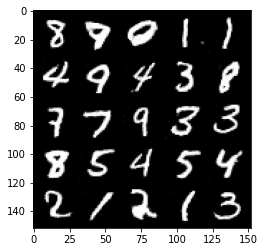

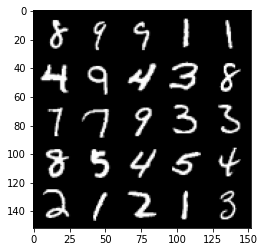

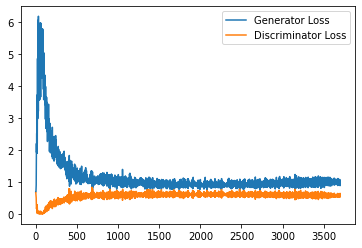

Epoch 158, step 74500: Generator loss: 0.9995905569791794, discriminator loss: 0.5843730792403221


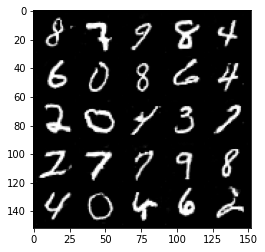

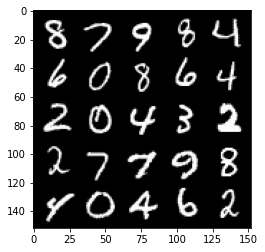

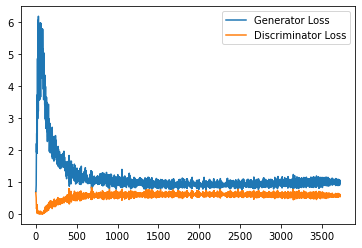

Epoch 159, step 75000: Generator loss: 1.0043082089424133, discriminator loss: 0.586675550699234


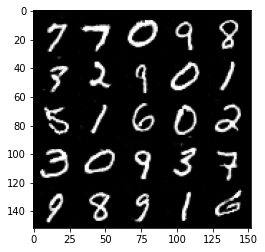

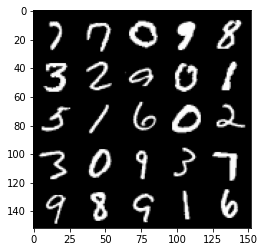

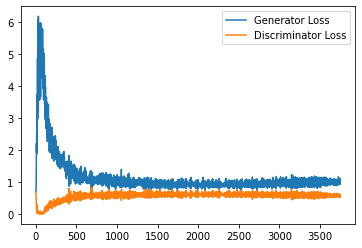

Epoch 160, step 75500: Generator loss: 1.0046971417665482, discriminator loss: 0.5875655491352081


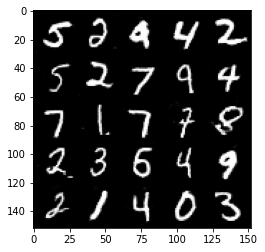

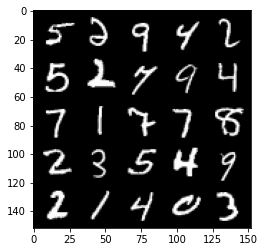

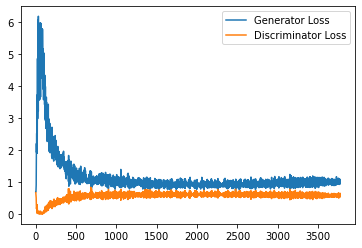

Epoch 162, step 76000: Generator loss: 1.0158492377996444, discriminator loss: 0.5881806294322014


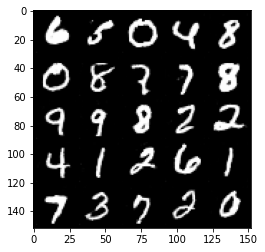

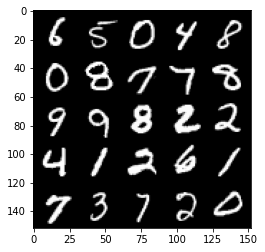

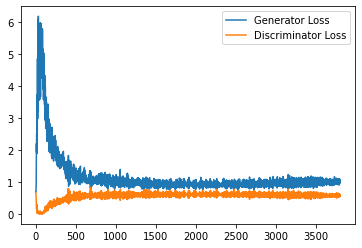

Epoch 163, step 76500: Generator loss: 1.0031479256153106, discriminator loss: 0.5901282263398171


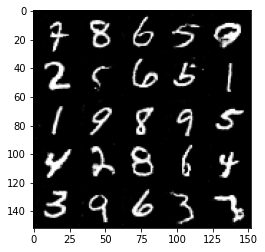

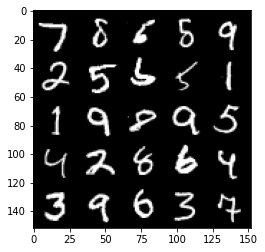

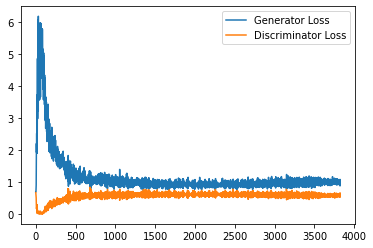

Epoch 164, step 77000: Generator loss: 1.0202848230600357, discriminator loss: 0.5863828284144401


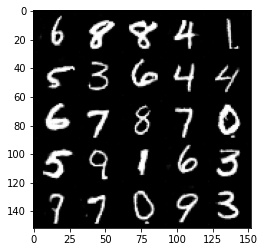

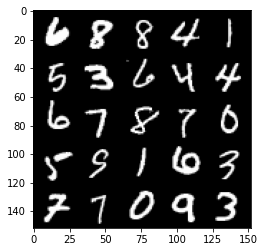

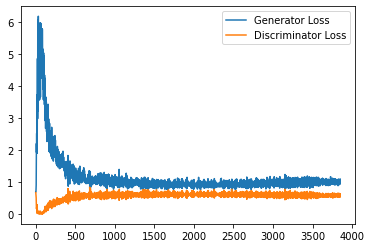

Epoch 165, step 77500: Generator loss: 0.9966893804073333, discriminator loss: 0.5913562442660332


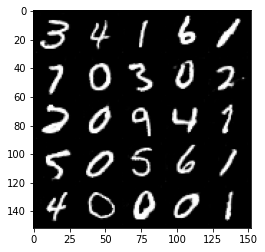

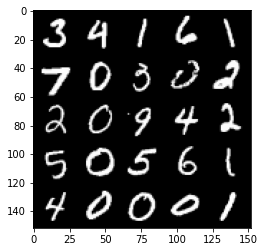

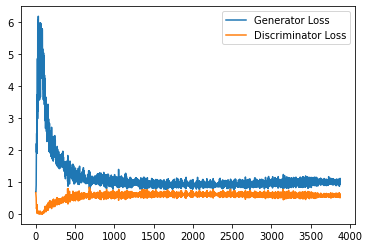

Epoch 166, step 78000: Generator loss: 1.0086640441417694, discriminator loss: 0.5897403372526169


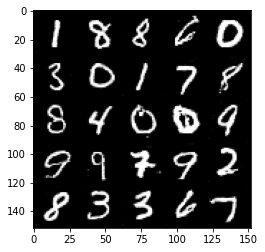

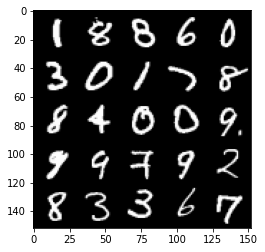

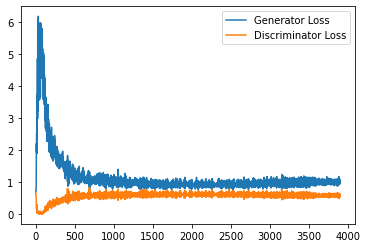

Epoch 167, step 78500: Generator loss: 1.002533439874649, discriminator loss: 0.5898787513971329


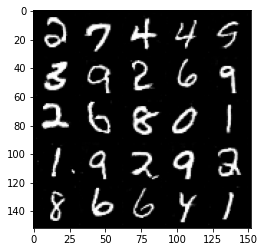

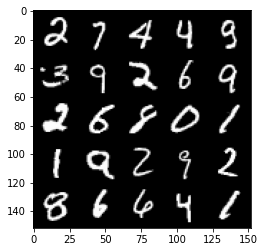

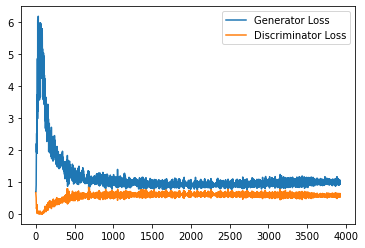

Epoch 168, step 79000: Generator loss: 1.005861030101776, discriminator loss: 0.588506391108036


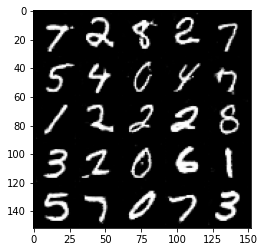

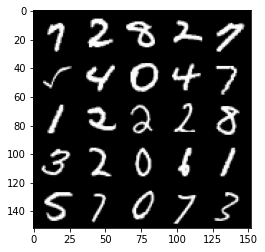

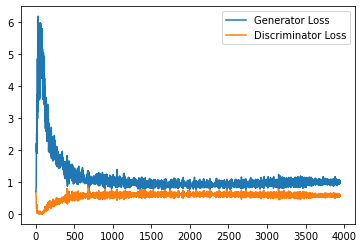

Epoch 169, step 79500: Generator loss: 1.011771262049675, discriminator loss: 0.5894392893910408


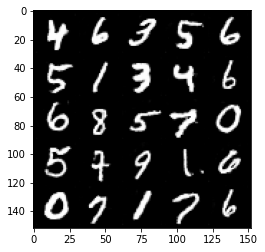

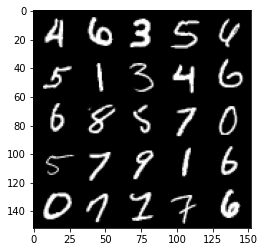

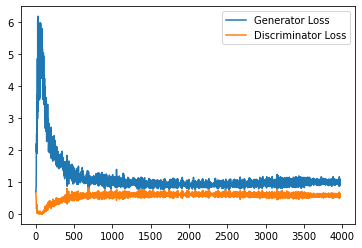

Epoch 170, step 80000: Generator loss: 1.0164789897203446, discriminator loss: 0.5899813996553421


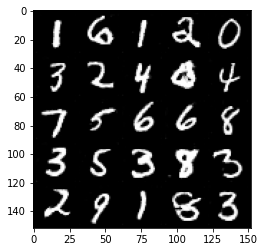

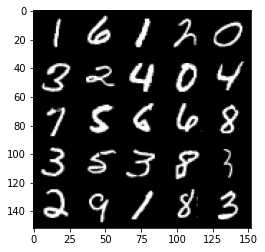

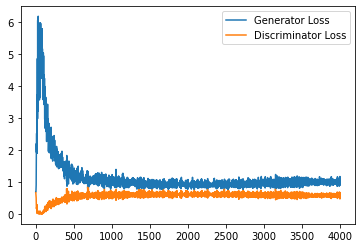

Epoch 171, step 80500: Generator loss: 1.0200833696126939, discriminator loss: 0.5903231317400932


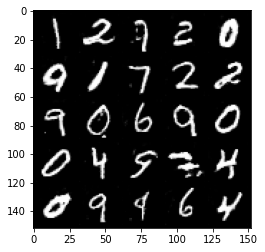

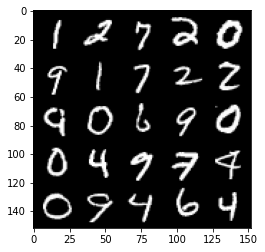

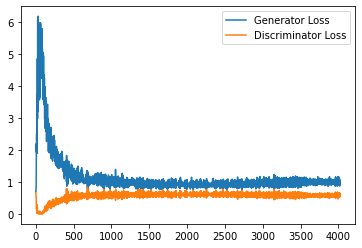

Epoch 172, step 81000: Generator loss: 1.006055897474289, discriminator loss: 0.5865825875997543


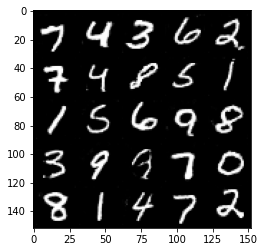

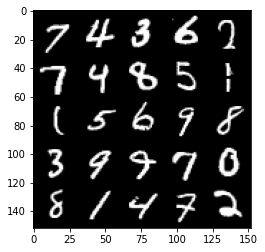

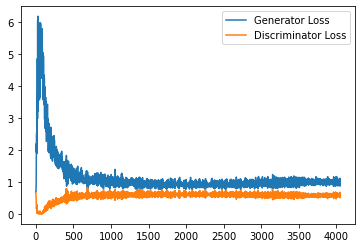

Epoch 173, step 81500: Generator loss: 1.0048133991956711, discriminator loss: 0.5936913505792618


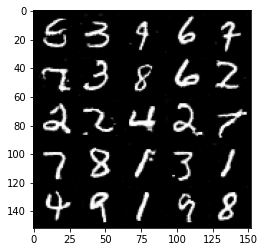

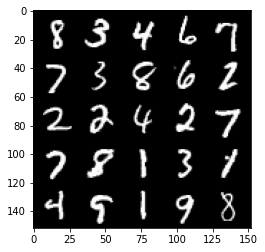

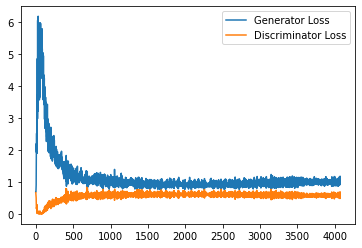

Epoch 174, step 82000: Generator loss: 1.0077628934383391, discriminator loss: 0.5903230050802231


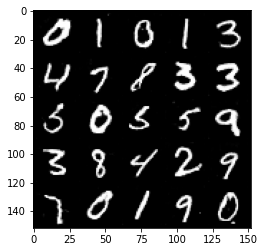

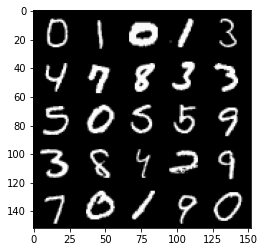

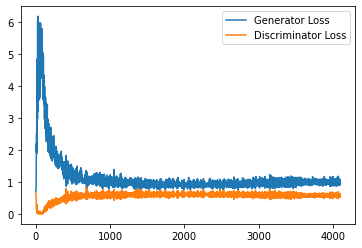

Epoch 175, step 82500: Generator loss: 0.9981351449489594, discriminator loss: 0.5880477116703987


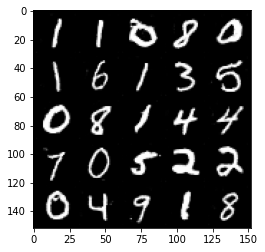

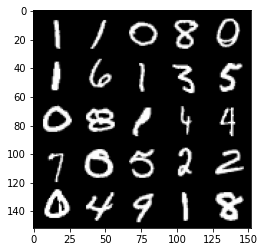

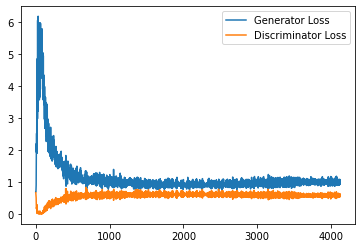

Epoch 176, step 83000: Generator loss: 1.005517217040062, discriminator loss: 0.5927822363972663


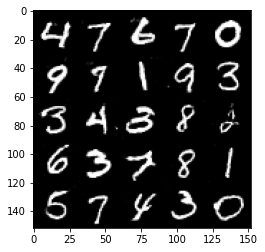

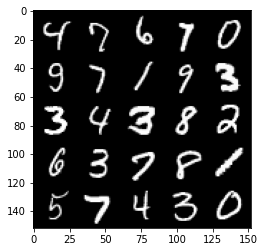

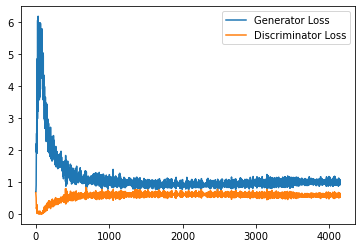

Epoch 178, step 83500: Generator loss: 0.9993892579078675, discriminator loss: 0.5912540485858917


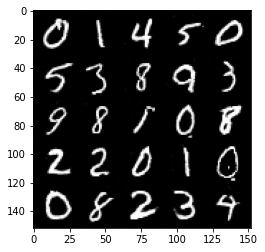

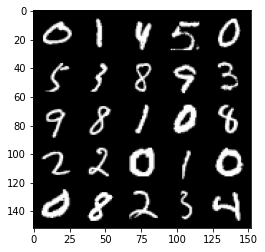

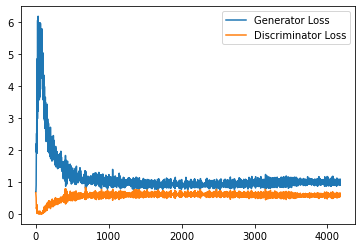

Epoch 179, step 84000: Generator loss: 1.0192652662992479, discriminator loss: 0.59084226500988


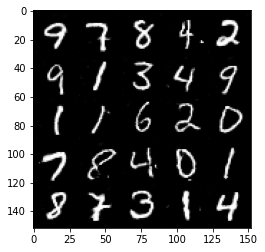

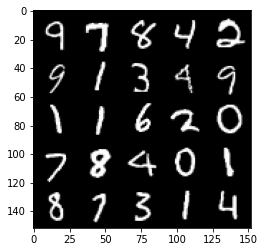

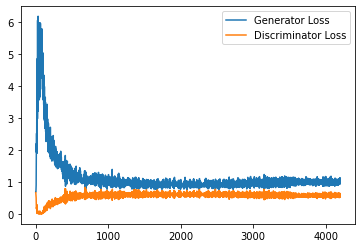

Epoch 180, step 84500: Generator loss: 1.0047647444009782, discriminator loss: 0.5938953051567077


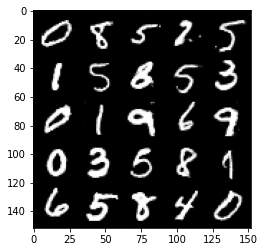

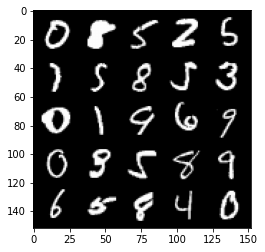

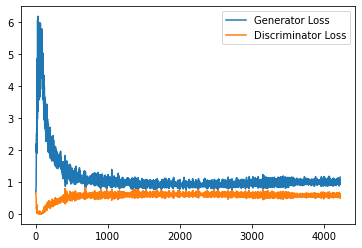

Epoch 181, step 85000: Generator loss: 1.0029250472784041, discriminator loss: 0.5928545160293579


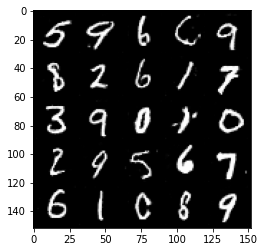

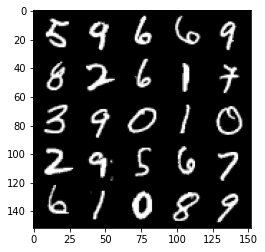

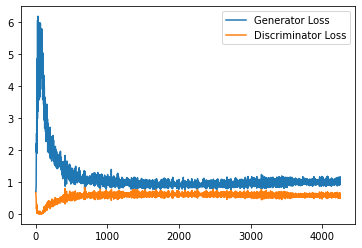

Epoch 182, step 85500: Generator loss: 1.0104966183900834, discriminator loss: 0.5961063544154167


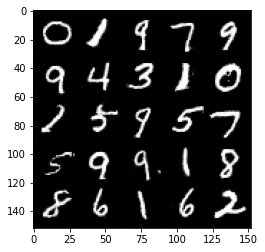

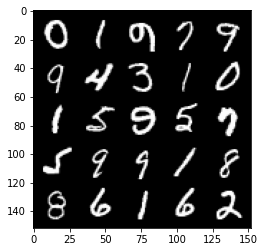

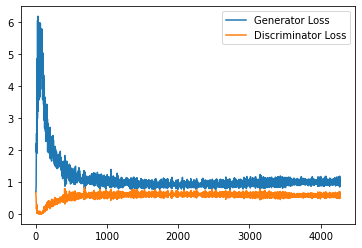

Epoch 183, step 86000: Generator loss: 1.0139903255701066, discriminator loss: 0.5919842401742935


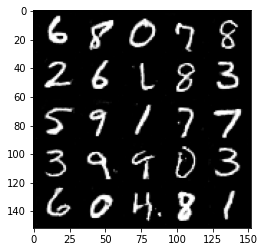

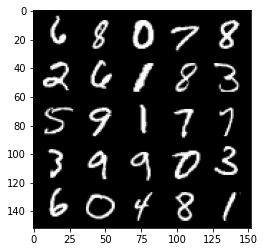

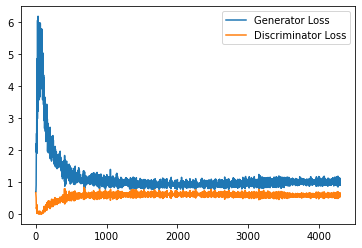

Epoch 184, step 86500: Generator loss: 0.9921906032562255, discriminator loss: 0.5977295858263969


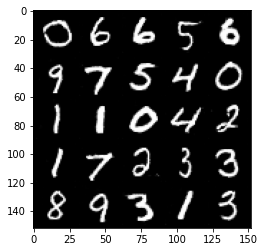

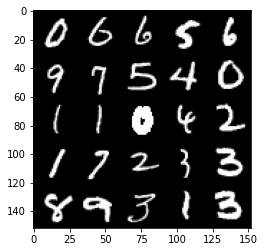

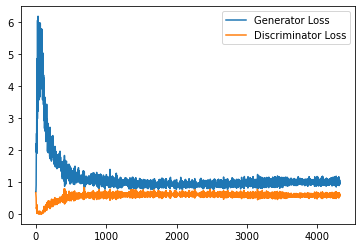

Epoch 185, step 87000: Generator loss: 1.0015481083393096, discriminator loss: 0.5926224840283394


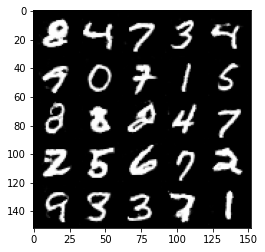

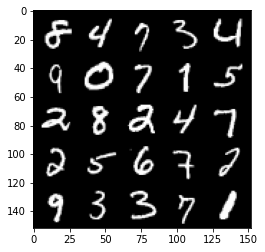

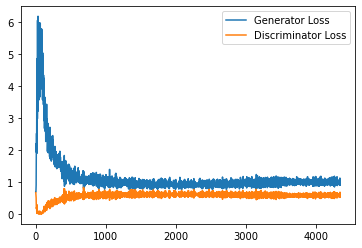

Epoch 186, step 87500: Generator loss: 1.0163660124540328, discriminator loss: 0.599187067747116


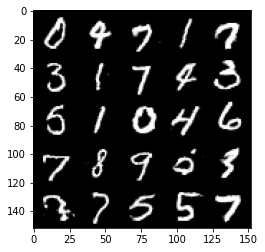

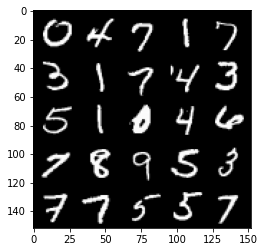

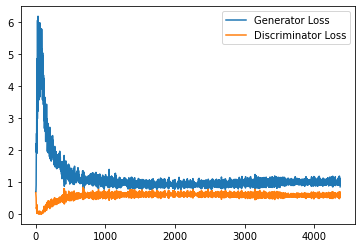

Epoch 187, step 88000: Generator loss: 1.0025509032011033, discriminator loss: 0.5962008016705513


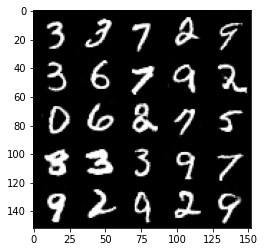

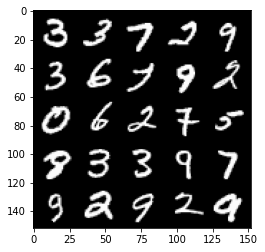

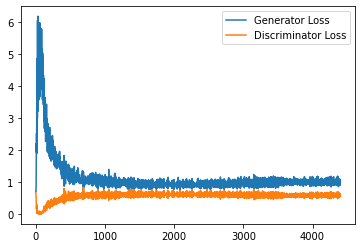

Epoch 188, step 88500: Generator loss: 0.9949748544692993, discriminator loss: 0.5936644134521485


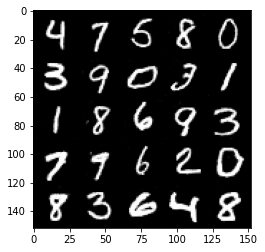

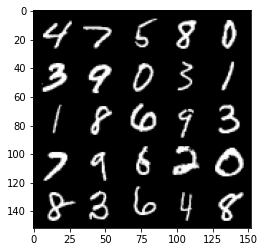

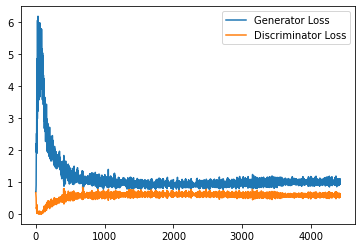

Epoch 189, step 89000: Generator loss: 1.0079266399145126, discriminator loss: 0.5986714360713958


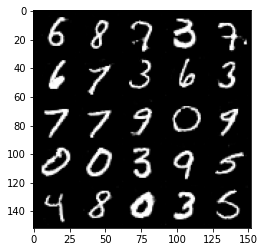

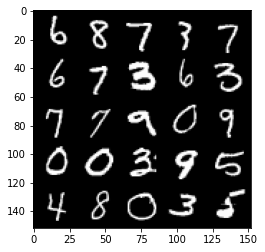

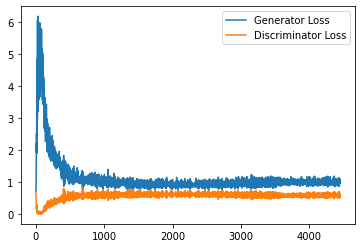

Epoch 190, step 89500: Generator loss: 1.0104717499017715, discriminator loss: 0.5948030142188072


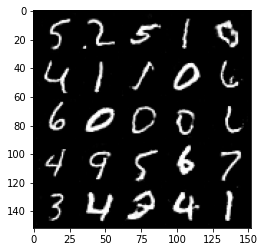

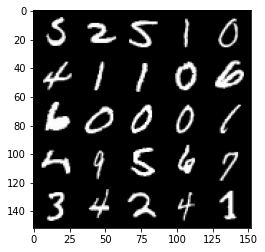

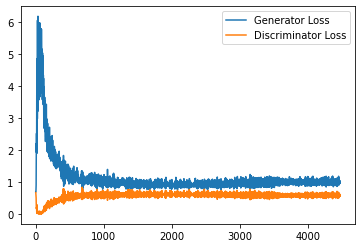

Epoch 191, step 90000: Generator loss: 0.9956900494098664, discriminator loss: 0.6003862058520317


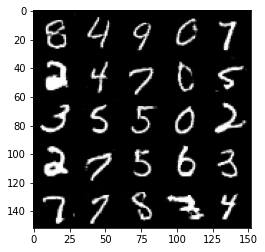

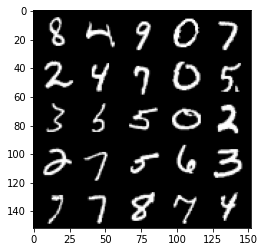

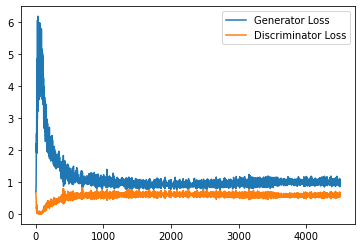

Epoch 192, step 90500: Generator loss: 1.0053095531463623, discriminator loss: 0.598125944674015


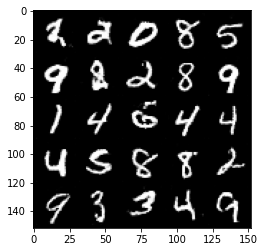

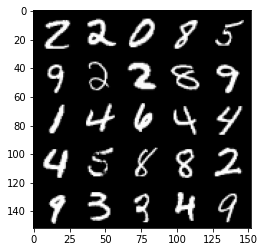

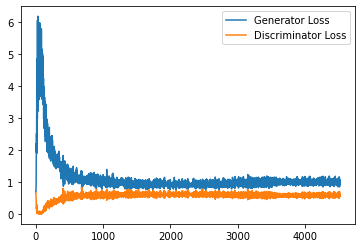

Epoch 194, step 91000: Generator loss: 1.0096263074874878, discriminator loss: 0.5984724264144897


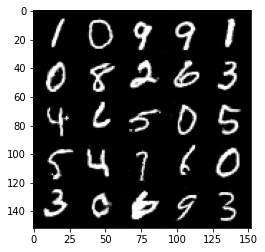

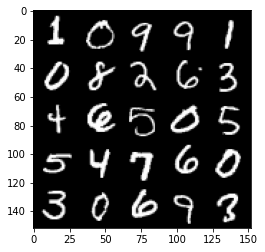

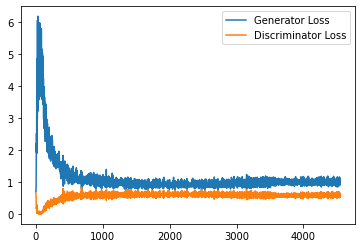

Epoch 195, step 91500: Generator loss: 0.9976489411592484, discriminator loss: 0.6078860788345337


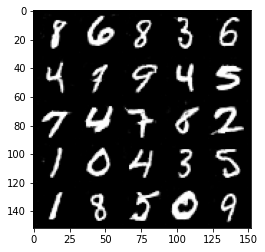

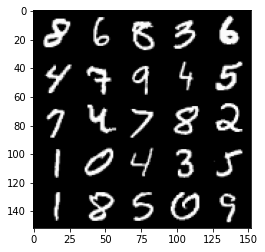

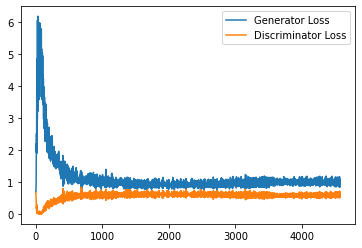

Epoch 196, step 92000: Generator loss: 0.9981874505281448, discriminator loss: 0.5979097205400467


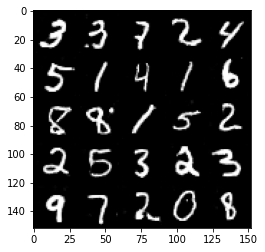

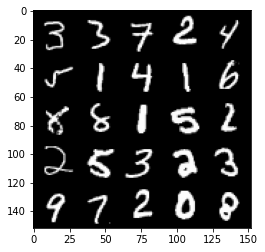

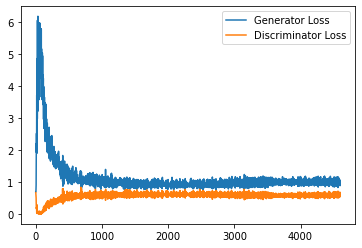

Epoch 197, step 92500: Generator loss: 0.981443767786026, discriminator loss: 0.6073416423201561


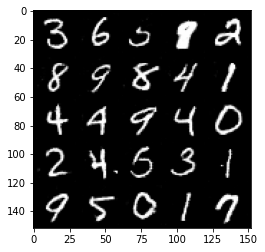

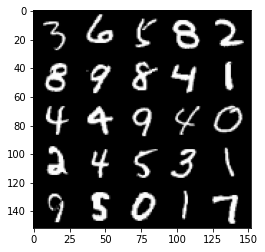

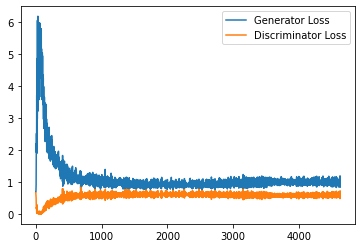

Epoch 198, step 93000: Generator loss: 1.0022620496749879, discriminator loss: 0.5963894896507264


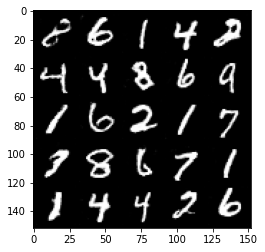

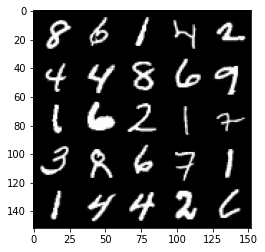

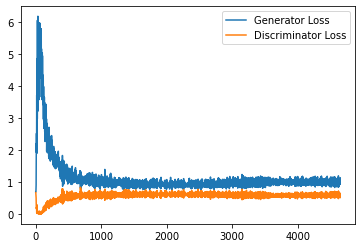

Epoch 199, step 93500: Generator loss: 0.9810800875425338, discriminator loss: 0.6027973464131355


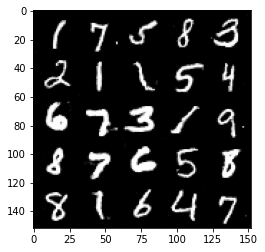

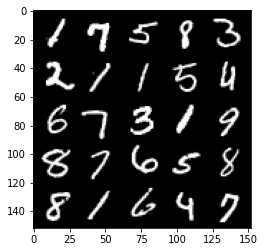

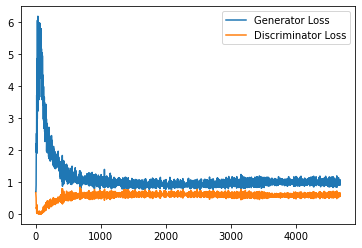

In [24]:

cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        noise_and_labels = combine_vectors(fake_noise,one_hot_labels,)
        fake = gen(noise_and_labels)
        
        # Make sure that enough images are generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now we can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        

        fake_image_and_labels = combine_vectors(fake,image_one_hot_labels)
        real_image_and_labels = combine_vectors(real,image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Epoch {epoch}, step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [25]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

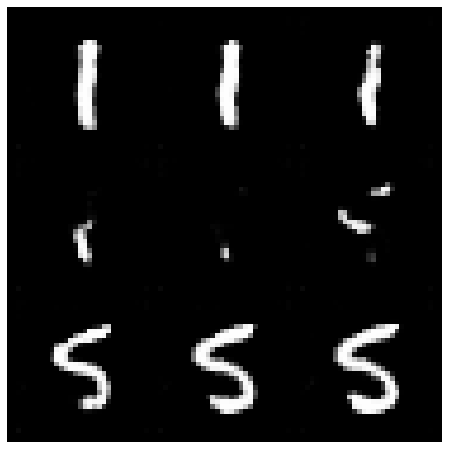

In [26]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

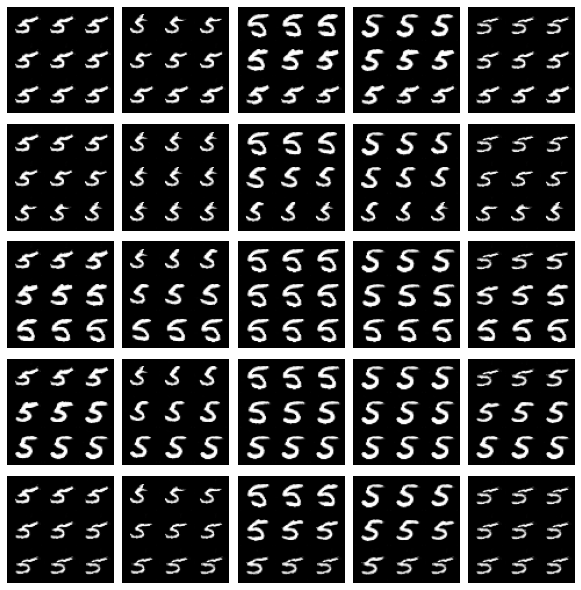

In [27]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()